# Transfer Learning for Computer Vision Tutorial
**Extended from [code](https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html) by [Sasank Chilamkurthy](https://chsasank.github.io).**  
License: BSD.

In this tutorial, you will learn how to train a convolutional neural network for
image classification using transfer learning. You can read more about the transfer
learning at the [CS231N notes](https://cs231n.github.io/transfer-learning/).

Quoting these notes:

    In practice, very few people train an entire Convolutional Network
    from scratch (with random initialization), because it is relatively
    rare to have a dataset of sufficient size. Instead, it is common to
    pretrain a ConvNet on a very large dataset (e.g. ImageNet, which
    contains 1.2 million images with 1000 categories), and then use the
    ConvNet either as an initialization or a fixed feature extractor for
    the task of interest.

These two major transfer learning scenarios look as follows:

-  **Finetuning the convnet**: Instead of random initializaion, we
   initialize the network with a pretrained network, like the one that is
   trained on imagenet 1000 dataset. Rest of the training looks as
   usual.
-  **ConvNet as fixed feature extractor**: Here, we will freeze the weights
   for all of the network except that of the final fully connected
   layer. This last fully connected layer is replaced with a new one
   with random weights and only this layer is trained.




### Running notes
If you are running this in Google Colab, be sure to change the runtime to GPU by clicking `Runtime > Change runtime type` and selecting "GPU" from the dropdown menu.

### Import relevant packages

In [ ]:
%matplotlib inline

In [ ]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [ ]:
from __future__ import print_function, division

import numpy as np
import matplotlib.pyplot as plt
import time
import os
import copy
plt.ion()   # interactive mode

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler

import torchvision
from torchvision import datasets, models, transforms

## Load Data

We will use `torchvision` and `torch.utils.data` packages for loading the
data.

The problem we're going to solve today is to train a model to classify
present and future **Israeli politicians**.  
We have about ~100 training images for each of our 9 politicians, automatically scraped from the first page of the Google Images Search without manual review.  
Usually, this is a very small dataset to generalize upon, if trained from scratch (or is it? We'll soon test this ourselves!). Since we are using transfer learning, we should be able to generalize reasonably well.

In [ ]:
# Create a folder for our data
# The ! prefix runs this as a shell command
!mkdir data
!mkdir data/israeli_politicians

In [ ]:
# Download our dataset and extract it
import requests
from zipfile import ZipFile

url = 'https://github.com/omriallouche/ydata_deep_learning_2021/blob/main/data/israeli_politicians.zip?raw=true'
r = requests.get(url, allow_redirects=True)
open('./data/israeli_politicians.zip', 'wb').write(r.content)

with ZipFile('./data/israeli_politicians.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall(path='./data/israeli_politicians/')

In [ ]:
# On Linux machines, the following simpler code can be used instead
# !wget https://github.com/omriallouche/ydata_deep_learning_2021/blob/main/data/israeli_politicians.zip?raw=true
# !unzip israeli_politicians.zip -d data/israeli_politicians/

### Dataset Review
At this stage, we suggest that you review your given data and get to know it better.  
Try to look for things that might interfere with its ability to learn and generalize.

### Datasets definition
PyTorch uses DataLoaders to define datasets. We'll create 2 data loaders, `train` and `val` (for validation).  
Our dataset was already split into different folders for these - as you can see under the "Files" menu on the left of the Colab.

In [ ]:
# Define transformations that resize the images to 256x256, and normalize them. 
# The means and standard deviations of each channel are the values used for normalization in ImageNet
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

In [ ]:
data_dir = r'./data/israeli_politicians/'

# Create a dictionary of train and val datasets from images in folders
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}

A data loader wraps an iterable around the Dataset to enable easy access to the samples. It combines a dataset and a sampler.

In [ ]:
dataloaders = {
    'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=16,
                                             shuffle=True, num_workers=4),
    'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=16,
                                          shuffle=False, num_workers=4)
  }

In [ ]:
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
print('dataset_sizes: ', dataset_sizes)

class_names = image_datasets['train'].classes
print('class_names:', class_names)

dataset_sizes:  {'train': 929, 'val': 234}
class_names: ['ayelet_shaked', 'benjamin_netanyahu', 'benny_gantz', 'danny_danon', 'gideon_saar', 'kostya_kilimnik', 'naftali_bennett', 'ofir_akunis', 'yair_lapid']


In [ ]:
# Check for the availability of a GPU, and use CPU otherwise
# If you are using Google Colab, be sure to change your runtime environment to GPU first.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

### Datasets and Dataloaders
Let's examine the dataloaders and datasets and learn more about their attributes and functions.  

In [ ]:
train_dataloader = dataloaders['train']

In Colab or Jupyter notebook, if we type  `train_dataloader.` and wait, we'd see a drop-down with the object attributes and functions.  

`train_dataloader.dataset.samples` contains the filenames + true labels (0 to 8 for our 9 classes).  
`train_dataloader.dataset.classes` contains the class names in order.  
`train_dataloader.dataset.class_to_idx` contains a map from a class name to the integer that represents it.

In [ ]:
train_dataloader.dataset.class_to_idx

{'ayelet_shaked': 0,
 'benjamin_netanyahu': 1,
 'benny_gantz': 2,
 'danny_danon': 3,
 'gideon_saar': 4,
 'kostya_kilimnik': 5,
 'naftali_bennett': 6,
 'ofir_akunis': 7,
 'yair_lapid': 8}

### Visualize a few images

Let's visualize a few training images so as to understand the data
augmentations.



In [ ]:
# A helper function to show an image from a tensor. We need to restore it to the original dynamic range before normalization
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array(means)
    std = np.array(stds)
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    fig = plt.figure(figsize=(5,3), dpi=300)
    plt.imshow(inp)
    if title is not None:
       plt.title(title, fontsize=5)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
# Get a batch of training data - the data loader is a generator
inputs, classes = next(iter(dataloaders['train']))

`inputs` is a tensor of shape `[16, 3, 256, 256]` - there are 16 images in the batch, each with 3 color channels (RGB), a width of 256 pixels, and a height of 256 pixels:

In [ ]:
inputs.shape

torch.Size([16, 3, 256, 256])

In [ ]:
inputs

tensor([[[[-0.9877, -0.9877, -0.9877,  ..., -1.2445, -1.2617, -1.2617],
          [-0.9877, -0.9877, -0.9877,  ..., -1.2445, -1.2617, -1.2617],
          [-0.9877, -0.9877, -0.9877,  ..., -1.2445, -1.2617, -1.2617],
          ...,
          [-1.5528, -1.5699, -1.5699,  ..., -1.8439, -1.8782, -1.9124],
          [-1.5699, -1.5699, -1.5870,  ..., -1.8097, -1.8610, -1.8953],
          [-1.5699, -1.5699, -1.5870,  ..., -1.7925, -1.8439, -1.8782]],

         [[-0.9853, -0.9853, -0.9853,  ..., -1.1078, -1.1253, -1.1253],
          [-0.9853, -0.9853, -0.9853,  ..., -1.1078, -1.1253, -1.1253],
          [-0.9853, -0.9853, -0.9853,  ..., -1.1078, -1.1253, -1.1253],
          ...,
          [-1.4230, -1.4405, -1.4405,  ..., -1.7556, -1.7906, -1.8256],
          [-1.4405, -1.4405, -1.4580,  ..., -1.7206, -1.7731, -1.8081],
          [-1.4405, -1.4405, -1.4580,  ..., -1.7031, -1.7556, -1.7906]],

         [[-0.1312, -0.1312, -0.1312,  ..., -0.1661, -0.1835, -0.1835],
          [-0.1312, -0.1312, -

`classes` is a tensor of size 16, containing numbers matching the true class of each image, from our 9 classes.

In [ ]:
classes

tensor([7, 1, 1, 1, 0, 4, 7, 6, 0, 6, 4, 4, 8, 7, 4, 2])

To map it to the class names, we can run:

In [ ]:
[class_names[c] for c in classes]

['ofir_akunis',
 'benjamin_netanyahu',
 'benjamin_netanyahu',
 'benjamin_netanyahu',
 'ayelet_shaked',
 'gideon_saar',
 'ofir_akunis',
 'naftali_bennett',
 'ayelet_shaked',
 'naftali_bennett',
 'gideon_saar',
 'gideon_saar',
 'yair_lapid',
 'ofir_akunis',
 'gideon_saar',
 'benny_gantz']

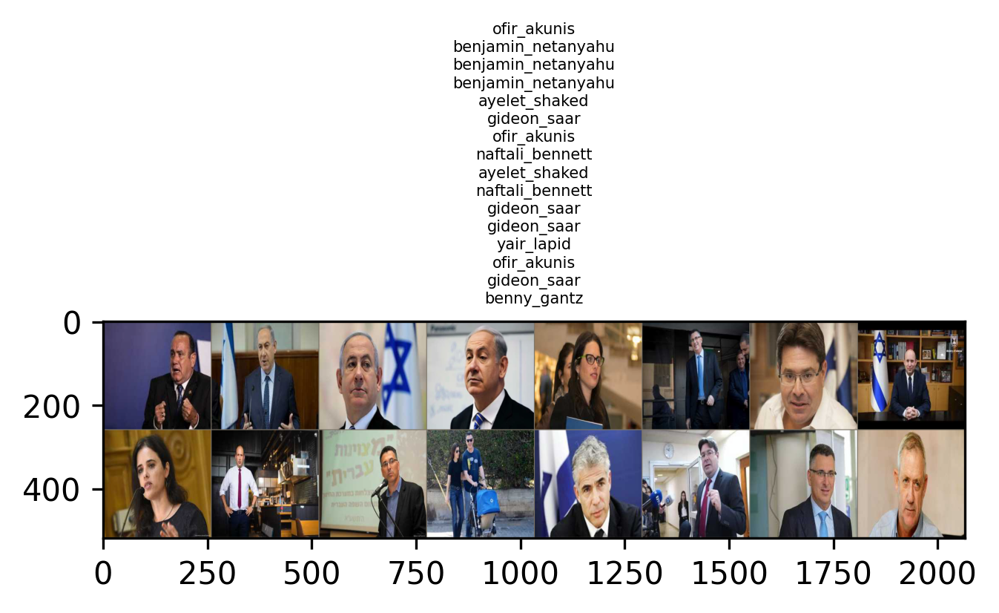

In [ ]:
# Make a grid from batch
out = torchvision.utils.make_grid(inputs, nrow=8)

imshow(out, title='\n'.join([class_names[x] for x in classes]))

### Using a pretrained model
Let's load a model pretrained on ImageNet, and use it for our task.  
We will use the VGG16 network, that won the ImageNet Challenge in 2016.

In [ ]:
from IPython import display
display.Image("./img/vgg_architecture.png")

The first time we load the model, it will be downloaded locally, and then cached for the future.

In [ ]:
# We load a pretrain model with its weights. Alternatively, one might want to only load the model architecture.
model = models.vgg16(pretrained=True)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

We can print the model to learn about its structure as shown below.  
In future lessons, we will learn to read this output.  
For now, we can see that it is composed of 2D Convolution layers, non-linear ReLU activation, and 2D Max pooling, followed by a few fully connected layers. 

In [ ]:
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

Keras has a useful model summary, that we can also use for PyTorch models:

In [ ]:
# !pip install torchsummary 
from torchsummary import summary
summary(model.to(device), (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
         MaxPool2d-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
        MaxPool2d-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
             ReLU-14          [-1, 256,

We can see above that the final layer is a fully connected layer, from 4096 neurons to 1000 neurons, with a total of `4096 * 1000 + 1000 = 4,097,000` parameters. We add 1000 weights for the bias term of each output neuron.  

So in total, VGG-16 has 138M parameters, and we've set them all to be trainable.

However, VGG-16 and other networks created for ImageNet all have 1,000 neurons in their output, since they classify images to one of the 1,000 categories in the ImageNet challenge.  
To use the network for our task, we need to replace the final fully-connected layer with one mapping to 9 neurons instead of 1000:

In [ ]:
# This code should output the number of input neurons to the final layer. We'll use it to create a new layer instead of it.
last_layer = list(model.children())[-1]
if hasattr(last_layer, 'in_features'):
  num_ftrs = last_layer.in_features
else:
  num_ftrs = last_layer[-1].in_features

num_ftrs

4096

To access and set a layer in the network, we reference it by name. In the example above, the final layer is `model.classifier[6]`.

In [ ]:
# Here the size of each output sample is set to 2.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model.classifier[6]

Linear(in_features=4096, out_features=1000, bias=True)

Let's now replace it with a linear layer with 4096 input features and 9 output features:

In [ ]:
model.classifier[6] = nn.Linear(in_features=4096, out_features=9)

Let's review our change in the model:

In [ ]:
model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
summary(model.to(device), (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
         MaxPool2d-5         [-1, 64, 128, 128]               0
            Conv2d-6        [-1, 128, 128, 128]          73,856
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8        [-1, 128, 128, 128]         147,584
              ReLU-9        [-1, 128, 128, 128]               0
        MaxPool2d-10          [-1, 128, 64, 64]               0
           Conv2d-11          [-1, 256, 64, 64]         295,168
             ReLU-12          [-1, 256, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
             ReLU-14          [-1, 256,

Next, we define the loss, optimizer and LR scheduler.

In [ ]:
# If a GPU is available, make the model use it
model = model.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterion = nn.CrossEntropyLoss()

# Use Stochastic Gradient Descent as the optimizer, with a learning rate of 0.001 and momentum
# Momentum simulates the corase of a heavy ball, and keeps moving in the direction of the previous gradient along with the new gradient. 
# Empirically it is known to show better convergence. We will learn about it in future lessons.
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

num_epochs = 10

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [ ]:
def train_model(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    # Init variables that will save info about the best model
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                # Set model to training mode. 
                model.train()  
            else:
                # Set model to evaluate mode. In evaluate mode, we don't perform backprop and don't need to keep the gradients
                model.eval()   

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data
            for inputs, labels in dataloaders[phase]:
                # Prepare the inputs for GPU/CPU
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # ===== forward pass ======
                with torch.set_grad_enabled(phase=='train'):
                    # If we're in train mode, we'll track the gradients to allow back-propagation
                    outputs = model(inputs) # apply the model to the inputs. The output is the softmax probability of each class
                    _, preds = torch.max(outputs, 1) # 
                    loss = criterion(outputs, labels)

                    # ==== backward pass + optimizer step ====
                    # This runs only in the training phase
                    if phase == 'train':
                        loss.backward() # Perform a step in the opposite direction of the gradient
                        optimizer.step() # Adapt the optimizer

                # Collect statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                
            if phase == 'train':
                # Adjust the learning rate based on the scheduler
                scheduler.step()  

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # Keep the results of the best model so far
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                # deepcopy the model
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {(time_elapsed // 60):.0f}m {(time_elapsed % 60):.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

## Finetuning the network




### Train and evaluate
It should take around 15-25 min on CPU. On GPU though, it takes less than a minute.

In [ ]:
model = train_model(model, 
                    dataloaders,
                    criterion, 
                    optimizer_ft, 
                    exp_lr_scheduler,
                    num_epochs=num_epochs)

Epoch 0/9
----------
train Loss: 1.8161 Acc: 0.3423
val Loss: 1.3996 Acc: 0.4487

Epoch 1/9
----------
train Loss: 1.0550 Acc: 0.6631
val Loss: 1.0478 Acc: 0.6538

Epoch 2/9
----------
train Loss: 0.9278 Acc: 0.6954
val Loss: 0.9720 Acc: 0.6923

Epoch 3/9
----------
train Loss: 0.4408 Acc: 0.8547
val Loss: 0.7378 Acc: 0.7521

Epoch 4/9
----------
train Loss: 0.2449 Acc: 0.9160
val Loss: 0.6944 Acc: 0.7863

Epoch 5/9
----------
train Loss: 0.1579 Acc: 0.9548
val Loss: 0.8253 Acc: 0.7778

Epoch 6/9
----------
train Loss: 0.1078 Acc: 0.9709
val Loss: 0.8381 Acc: 0.8034

Epoch 7/9
----------
train Loss: 0.0374 Acc: 0.9925
val Loss: 0.6880 Acc: 0.8205

Epoch 8/9
----------
train Loss: 0.0163 Acc: 0.9968
val Loss: 0.6912 Acc: 0.8162

Epoch 9/9
----------
train Loss: 0.0167 Acc: 0.9957
val Loss: 0.7076 Acc: 0.8291

Training complete in 10m 44s
Best val Acc: 0.829060


### Visualizing the model predictions

Let's define a generic function to display our model's predictions for a few images:




In [ ]:
def visualize_model(model, num_images=6):    
    # Record the train/evaluate mode of the model, to restore it after we're done
    was_training = model.training
    # Set the model mode to evaluate
    model.eval()
    
    images_so_far = 0
    plt.figure(figsize=(2,1), dpi=300)

    with torch.no_grad(): # No need to collect gradients when generating predictions
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1

                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
                
        # Restore the model's train/evaluate mode
        model.train(mode=was_training)

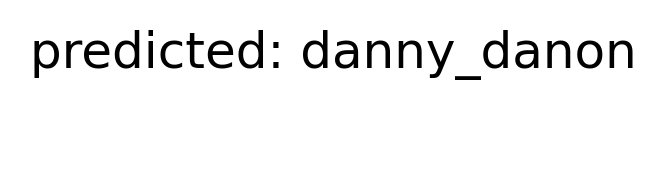

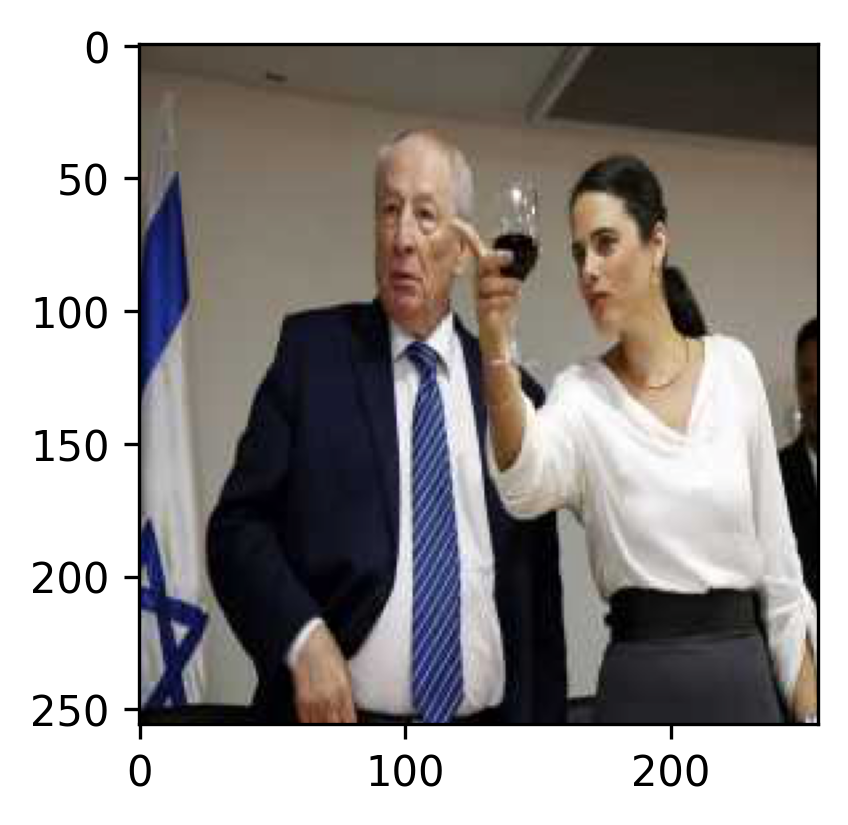

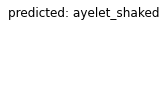

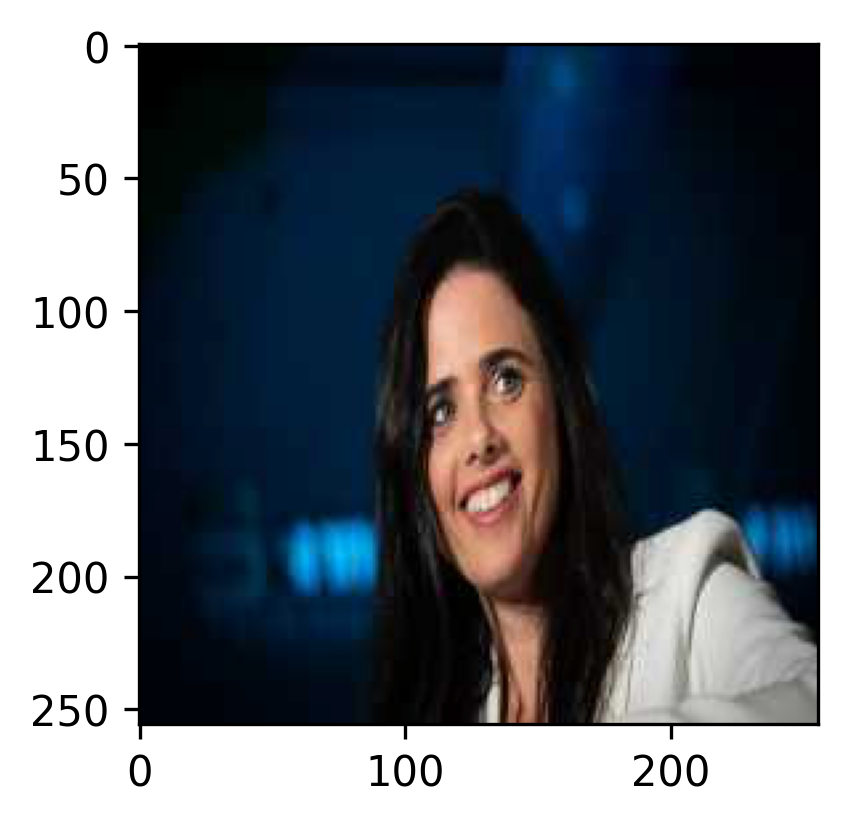

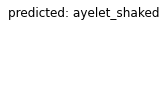

...

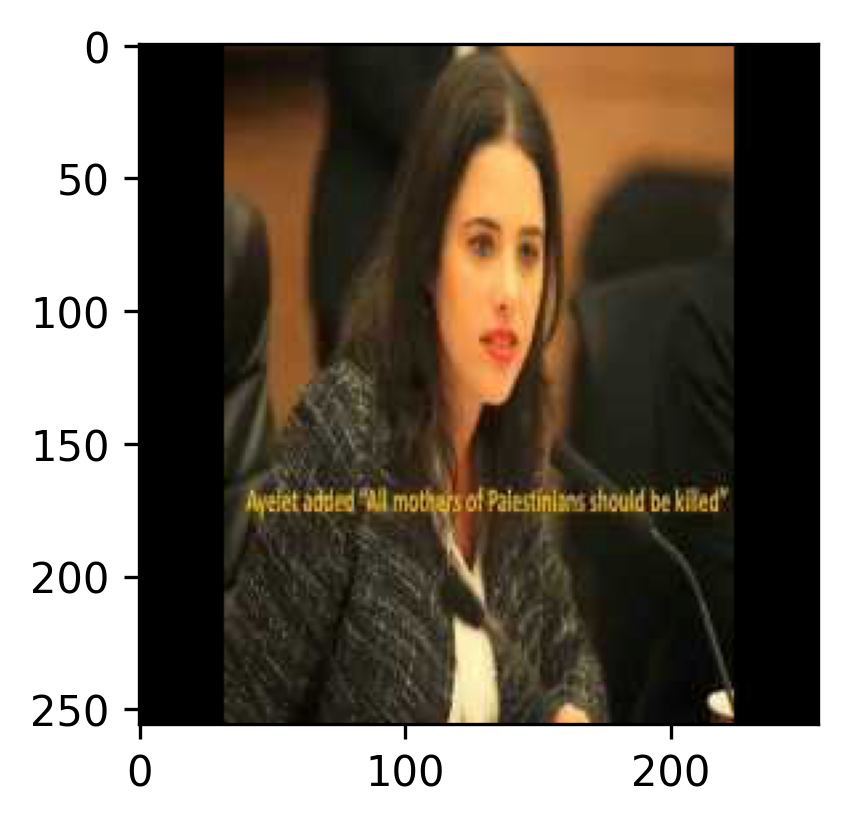

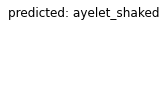

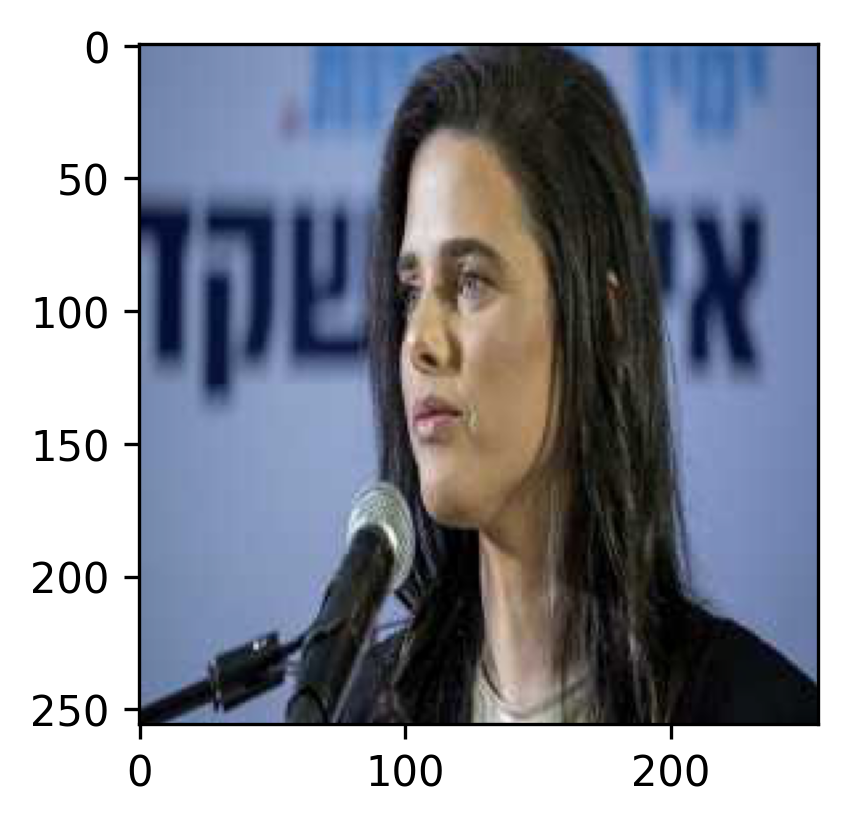

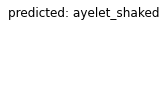

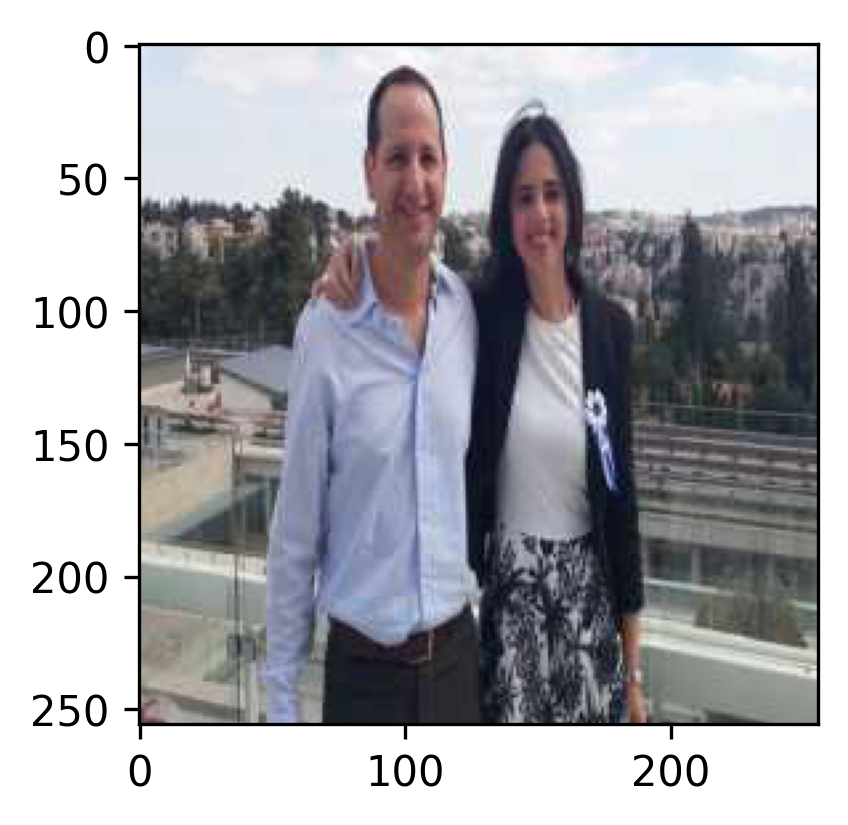

In [ ]:
visualize_model(model)

# Additional Tasks
In the sections below, you'll experiment with PyTorch and NN yourself.  

Before you start having fun on your own, let's review together how to get some predictions from our trained model.  

As we've done in both our training and visualization code, we apply the model to input with the command:  
```python
outputs = model(inputs)
```

The relevant code:

In [ ]:
inputs, labels = next(iter(dataloaders['train']))
inputs = inputs.to(device)
print(inputs)

labels = labels.to(device)
print(labels)

tensor([[[[-1.6384, -1.6213, -1.5870,  ..., -0.6794, -0.6794, -0.6794],
          [-1.6384, -1.6213, -1.5870,  ..., -0.6794, -0.6794, -0.6794],
          [-1.6384, -1.6213, -1.5870,  ..., -0.6623, -0.6623, -0.6623],
          ...,
          [-0.1999, -0.1999, -0.1999,  ..., -1.9638, -1.9809, -1.9809],
          [-0.1657, -0.1657, -0.1657,  ..., -1.9638, -1.9809, -1.9809],
          [-0.1486, -0.1486, -0.1486,  ..., -1.9638, -1.9809, -1.9809]],

         [[-1.7031, -1.6856, -1.6506,  ..., -0.8452, -0.8452, -0.8452],
          [-1.7031, -1.6856, -1.6506,  ..., -0.8452, -0.8452, -0.8452],
          [-1.7031, -1.6856, -1.6506,  ..., -0.8277, -0.8277, -0.8277],
          ...,
          [-0.5476, -0.5476, -0.5476,  ..., -1.8782, -1.8957, -1.8957],
          [-0.5126, -0.5126, -0.5126,  ..., -1.8782, -1.8957, -1.8957],
          [-0.4951, -0.4951, -0.4951,  ..., -1.8782, -1.8957, -1.8957]],

         [[-1.7696, -1.7173, -1.6824,  ..., -1.0550, -1.0550, -1.0550],
          [-1.7696, -1.7173, -

Note that we got tensors. We can convert them into numpy objects. Since we've previously set them to use GPU, We'll need to set them to use CPU first:

In [ ]:
labels.cpu().numpy()

array([1, 1, 8, 6, 0, 1, 3, 7, 6, 7, 4, 0, 4, 8, 0, 0])

In [ ]:
outputs = model(inputs)

print(outputs.shape)
print(outputs)

torch.Size([16, 9])
tensor([[ -4.8166,   9.7304,  -0.9020,   2.4674,   2.8634,  -4.2124,  -0.4911,
          -3.0316,  -0.9584],
        [-10.0044,  32.8199,   4.4120,  -5.0475,  -2.2016,  -6.1999,   1.1413,
         -11.2461,  -0.6215],
        [ -4.4935,  -8.3217,   0.9241,  -3.0653,   5.8111,  -1.8226,  -4.8266,
          -1.5418,  16.4166],
        [  4.7815,  -0.0391,  -2.8262,  -0.1114,  -0.8868,  -0.3374,   5.2096,
          -5.2682,   0.3758],
        [  9.2706,  -4.8941,  -5.9213,   2.8714,  -0.6795,  -2.4148,   0.7503,
           0.8014,   0.9722],
        [ -3.4524,  18.7751,  -2.6163,  -4.3221,  -2.8512,   0.6976,   3.1159,
         -10.6855,   3.9854],
        [  3.6711,  -0.8803,  -9.8338,  20.6174,   2.5414,  -7.3799,  -0.8005,
           1.5452,  -6.0245],
        [ -0.0779,  -6.7667,  -5.0260,   4.5286,  -0.1266,  -4.5603,  -3.6214,
          16.5305,  -0.9754],
        [  2.5264,   1.2023,  -4.7345,  -5.0801,   1.4908,   1.3624,  17.5116,
          -8.8992,  -3.5309],

Note that `outputs` have 16 "rows", one for each of the images in our batch, and each "row" has 9 values, for each of our classes.  
The values are the activations of the neurons, before applying the softmax function to them. To apply the softmax function to them, we can run:

In [ ]:
torch.nn.functional.softmax(outputs, dim=1).cpu().detach().numpy()

array([[4.8034843e-07, 9.9817312e-01, 2.4077430e-05, 6.9975568e-04,
        1.0397304e-03, 8.7890663e-07, 3.6315912e-05, 2.8625461e-06,
        2.2758362e-05],
       [2.5213610e-19, 1.0000000e+00, 4.5983557e-13, 3.5844691e-17,
        6.1712645e-16, 1.1321837e-17, 1.7464137e-14, 7.2840051e-20,
        2.9964015e-15],
       [8.2955665e-10, 1.8041194e-11, 1.8692636e-07, 3.4603120e-09,
        2.4778512e-05, 1.1989538e-08, 5.9455602e-10, 1.5876502e-08,
        9.9997497e-01],
       [3.8878682e-01, 3.1343240e-03, 1.9308784e-04, 2.9157731e-03,
        1.3427371e-03, 2.3260242e-03, 5.9653819e-01, 1.6794547e-05,
        4.7462676e-03],
       [9.9762756e-01, 7.0361278e-07, 2.5188271e-07, 1.6589143e-03,
        4.7608326e-05, 8.3959594e-06, 1.9891172e-04, 2.0932408e-04,
        2.4831787e-04],
       [2.2217898e-10, 9.9999940e-01, 5.1266613e-10, 9.3113059e-11,
        4.0533427e-10, 1.4093536e-08, 1.5823295e-07, 1.6046606e-13,
        3.7749996e-07],
       [4.3685777e-08, 4.6100157e-10, 5.

## Task 1: Plot model convergence
Adapt the code above to plot the loss and the accuracy every epoch. Show both the training and the validation performance.  
Does our model overfit?  
Do you have suggestions following these graphs? 

In [ ]:
# Create new data loaders
dataloadersv2 = {
    'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=16,
                                             shuffle=True, num_workers=4),
    'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=16,
                                          shuffle=False, num_workers=4)
  }

# We load a pretrain model with its weights. Alternatively, one might want to only load the model architecture.
modelv2 = models.vgg16(pretrained=True)

# Replace the last layer with linear layer matching the number of classes we want to predict on
modelv2.classifier[6] = nn.Linear(in_features=4096, out_features=9)

# Set the additional requirements and initilize a new criterion / optimizer / LR scheduler
modelv2 = modelv2.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterionv2 = nn.CrossEntropyLoss()

# Use Stochastic Gradient Descent as the optimizer, with a learning rate of 0.001 and momentum
# Momentum simulates the corase of a heavy ball, and keeps moving in the direction of the previous gradient along with the new gradient. 
# Empirically it is known to show better convergence. We will learn about it in future lessons.
optimizer_ftv2 = optim.SGD(modelv2.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_schedulerv2 = lr_scheduler.StepLR(optimizer_ftv2, step_size=7, gamma=0.1)

num_epochs = 10


In [ ]:
# Create a new train method that will return the loss and accuracy per dataset

def train_modelv2(model, dataloaders, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    # Init variables that will save info about the best model
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    training_results = {p: [] for p in ['train', 'val']}

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                # Set model to training mode. 
                model.train()  
            else:
                # Set model to evaluate mode. In evaluate mode, we don't perform backprop and don't need to keep the gradients
                model.eval()   

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data
            for inputs, labels in dataloaders[phase]:
                # Prepare the inputs for GPU/CPU
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # ===== forward pass ======
                with torch.set_grad_enabled(phase=='train'):
                    # If we're in train mode, we'll track the gradients to allow back-propagation
                    outputs = model(inputs) # apply the model to the inputs. The output is the softmax probability of each class
                    _, preds = torch.max(outputs, 1) # 
                    loss = criterion(outputs, labels)

                    # ==== backward pass + optimizer step ====
                    # This runs only in the training phase
                    if phase == 'train':
                        loss.backward() # Perform a step in the opposite direction of the gradient
                        optimizer.step() # Adapt the optimizer

                # Collect statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                
            if phase == 'train':
                # Adjust the learning rate based on the scheduler
                scheduler.step()  

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]
            training_results[phase].append({'epoch': epoch, 'epoch_loss': epoch_loss, 'epoch_acc': epoch_acc})

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # Keep the results of the best model so far
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                # deepcopy the model
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {(time_elapsed // 60):.0f}m {(time_elapsed % 60):.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, training_results

In [ ]:
# Training the model
modelv2_trained, train_stats = train_modelv2(modelv2, 
                              dataloadersv2,
                              criterionv2, 
                              optimizer_ftv2, 
                              exp_lr_schedulerv2,
                              num_epochs=num_epochs)

Epoch 0/9
----------
train Loss: 1.7657 Acc: 0.3617
val Loss: 1.4413 Acc: 0.4658

Epoch 1/9
----------
train Loss: 1.0372 Acc: 0.6480
val Loss: 1.0921 Acc: 0.6239

Epoch 2/9
----------
train Loss: 0.5932 Acc: 0.8030
val Loss: 0.9813 Acc: 0.7308

Epoch 3/9
----------
train Loss: 0.2822 Acc: 0.8945
val Loss: 0.7999 Acc: 0.7607

Epoch 4/9
----------
train Loss: 0.2143 Acc: 0.9279
val Loss: 0.8199 Acc: 0.7607

Epoch 5/9
----------
train Loss: 0.1908 Acc: 0.9386
val Loss: 0.9529 Acc: 0.7436

Epoch 6/9
----------
train Loss: 0.0802 Acc: 0.9774
val Loss: 0.9555 Acc: 0.7821

Epoch 7/9
----------
train Loss: 0.0302 Acc: 0.9903
val Loss: 0.8498 Acc: 0.8077

Epoch 8/9
----------
train Loss: 0.0165 Acc: 0.9957
val Loss: 0.8454 Acc: 0.8034

Epoch 9/9
----------
train Loss: 0.0166 Acc: 0.9946
val Loss: 0.8359 Acc: 0.8034

Training complete in 10m 18s
Best val Acc: 0.807692


In [ ]:
import seaborn as sns
import pandas as pd

# Plotting the results
train_stats_df = pd.DataFrame(train_stats['train'])
train_stats_df['Dataset'] = 'train'
train_stats_df.epoch_acc = train_stats_df.epoch_acc.apply(lambda x: x.cpu().detach().numpy())
val_stats_df = pd.DataFrame(train_stats['val'])
val_stats_df['Dataset'] = 'validation'
val_stats_df.epoch_acc = val_stats_df.epoch_acc.apply(lambda x: x.cpu().detach().numpy())
unified_df = pd.concat([train_stats_df, val_stats_df]).reset_index(drop=True)

[Text(0.5, 1.0, 'Accuracy over epochs')]

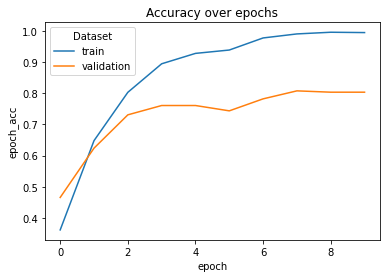

In [ ]:
sns.lineplot(data=unified_df, hue='Dataset', x='epoch', y='epoch_acc').set(title="Accuracy over epochs")

[Text(0.5, 1.0, 'Loss over epochs')]

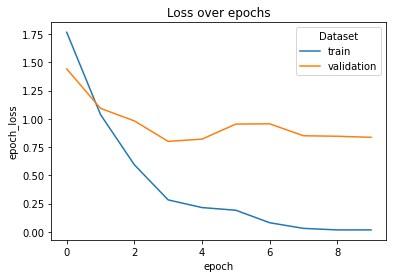

In [ ]:
sns.lineplot(data=unified_df, hue='Dataset', x='epoch', y='epoch_loss').set(title="Loss over epochs")

It seems that our model overfits as our dataset is rather small and we see that the train performance increased (to almost perfect) while our validation set performance stays similar and even decreases.

My suggestion:
- Get a lot of additional labelled samples to the train dataset per politition.
- Run the training with early stop of X iterations (even 50-100 if we have the computational resources) and re-evaluate the results.

## Task 2: Evaluate the model performance
Write code that shows the performance of our model.  
Show the classification report and the confusion matrix.  

What can you say about the model so far?  
Can you suggest a few ideas to improve it?

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

full_inputs = []
full_labels = []
full_preds  = [] # integer
full_raw_preds = [] # softmax

for inputs,labels in iter(dataloaders['val']):
  inputs = inputs.to(device)
  labels = labels.to(device)

  outputs = model(inputs)
  _, preds = torch.max(outputs, 1)

  full_inputs.append(inputs.cpu().detach().numpy())
  full_labels.append(labels.cpu().detach().numpy())
  full_raw_preds.append(outputs.cpu().detach().numpy())
  full_preds.append(preds.cpu().detach().numpy())
  # break 

full_inputs = np.concatenate(full_inputs)
full_labels = np.concatenate(full_labels)
full_preds = np.concatenate(full_preds)
full_raw_preds = np.concatenate(full_raw_preds)



##### Classification report

In [ ]:
print(classification_report(y_true=full_labels, y_pred=full_preds))

              precision    recall  f1-score   support

           0       0.84      0.88      0.86        24
           1       0.81      0.88      0.84        58
           2       0.86      0.55      0.67        22
           3       0.83      0.86      0.84        22
           4       0.83      0.83      0.83        24
           5       0.50      0.67      0.57         3
           6       0.79      0.65      0.71        23
           7       0.91      0.94      0.93        34
           8       0.81      0.92      0.86        24

    accuracy                           0.83       234
   macro avg       0.80      0.80      0.79       234
weighted avg       0.83      0.83      0.83       234



##### Confution Matrix

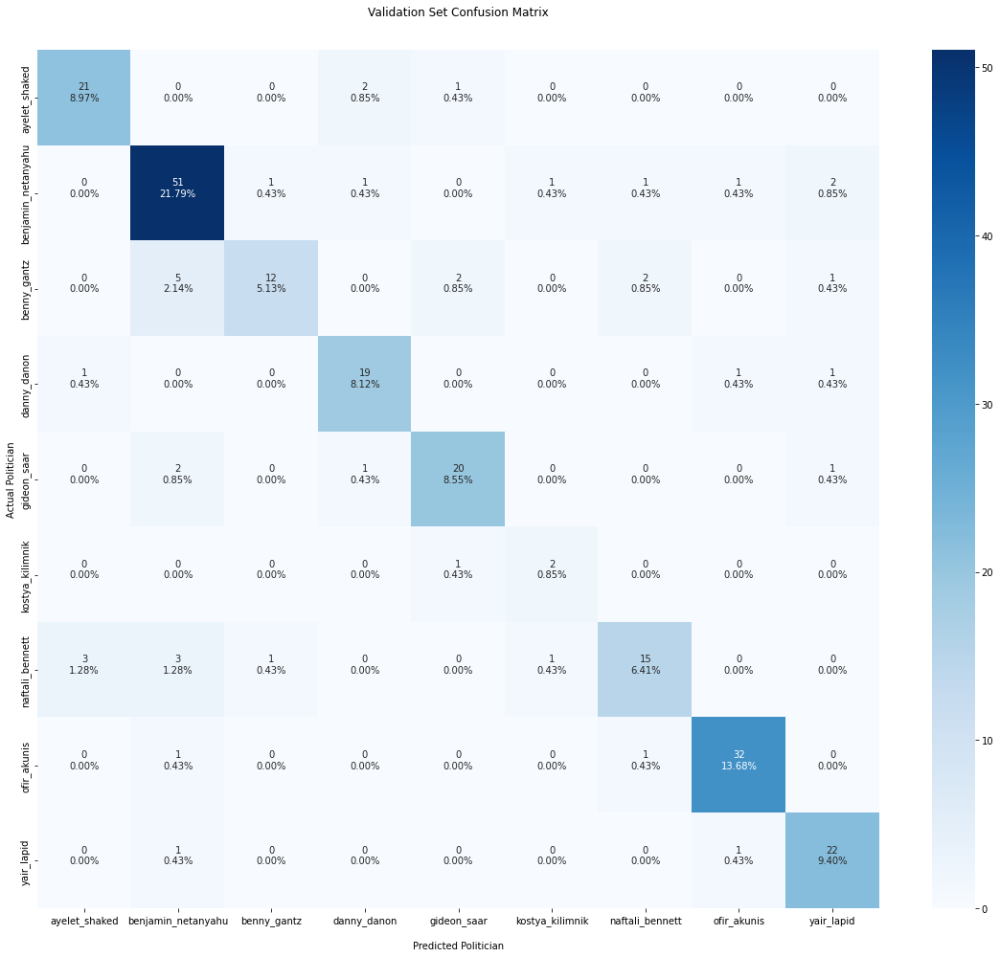

In [ ]:
import seaborn as sns 

plt.figure(figsize=(16,14))

cfm = confusion_matrix(y_true=full_labels, y_pred=full_preds)

group_counts = ["{0:0.0f}".format(value) for value in
                cfm.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cfm.flatten()/np.sum(cfm)]

labels = [f"{v1}\n{v2}\n" for v1, v2 in
          zip(group_counts,group_percentages)]

labels = np.asarray(labels).reshape(cfm.shape)

ax = sns.heatmap(cfm, annot=labels, fmt='', cmap='Blues')


ax.set_title('Validation Set Confusion Matrix\n\n');
ax.set_xlabel('\nPredicted Politician')
ax.set_ylabel('Actual Politician');

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(class_names)
ax.yaxis.set_ticklabels(class_names)

## Display the visualization of the Confusion Matrix.
plt.tight_layout()
plt.show()

##### What can you say about the model so far?

Seems like the model classifies our politicians in a decent manner, although it has some mistakes, specifically I've noticed more mistakes around:

- Classifying Bennet: The model classified him as Ayelet Shaked (3 times) / Benjamin Netanyahu (3 times). 
- Classifying Gantz: The model classified him as Benjamin Netanyahu (5 times).

##### Can you suggest a few ideas to improve it?

- Review Bennet and Gantz photos in the train set, looking for problematic photos and mutual photos (as we've already seen above) - Remove such photos if possible.
- Seems like Benjamin Netanyahu has the most photos in the validation set, we can check if its the same distribution in the train set and if it is our goal to classify BB the best or every single one of them equally.
- We can consider adding more unique photos to the train set of the ones we classified wrongly

## Task 3: Perform Error Analysis 
Error Analysis is an extremely important practice in Machine Learning research. It is rare that our base model works great out of the box. Proper error analysis helps us detect and fix issues in our DL code, data preprocessing and even in the data itself.

#### Review examples of top errors
One of the basic techniques of Error Analysis is manually reviewing the top errors of the model - samples where the model was most confident about one class, but the true label was different.  
Plot the top 10 errors of the model for each true class.  
Do you spot any issue or pattern?  
Try to see if you can improve the performance of the model following your insights.

#### Solution

Since we do not have a lot of errors (less than 10 per class), lets try to look at them manually


##########################
Errors for class 0 - ayelet_shaked
##########################



Actual: ayelet_shaked
Predicted: danny_danon


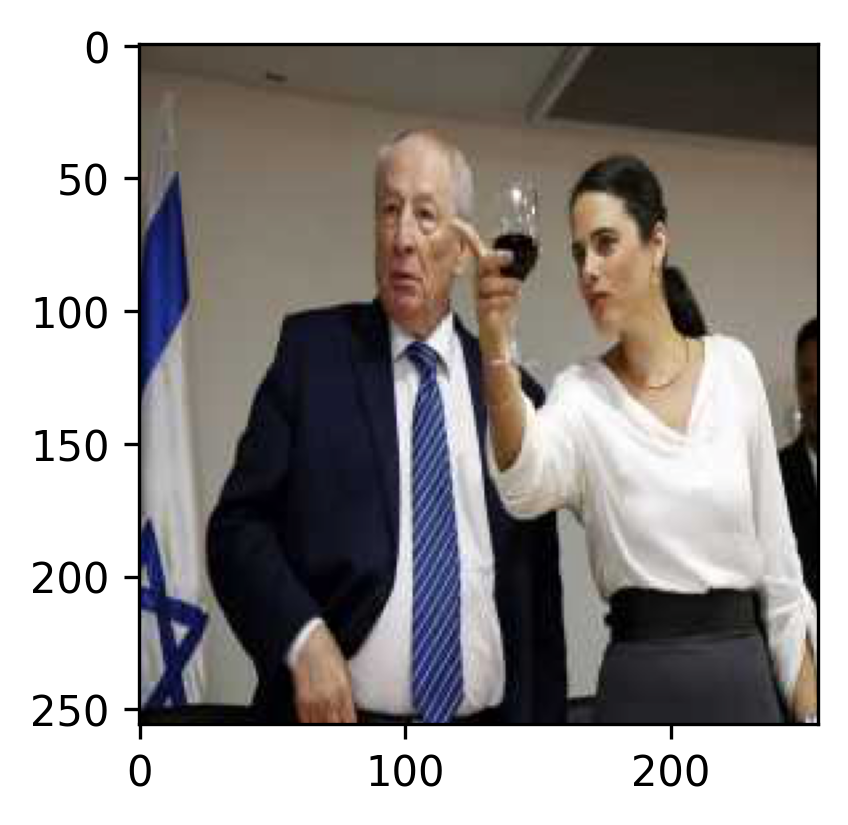



Actual: ayelet_shaked
Predicted: danny_danon


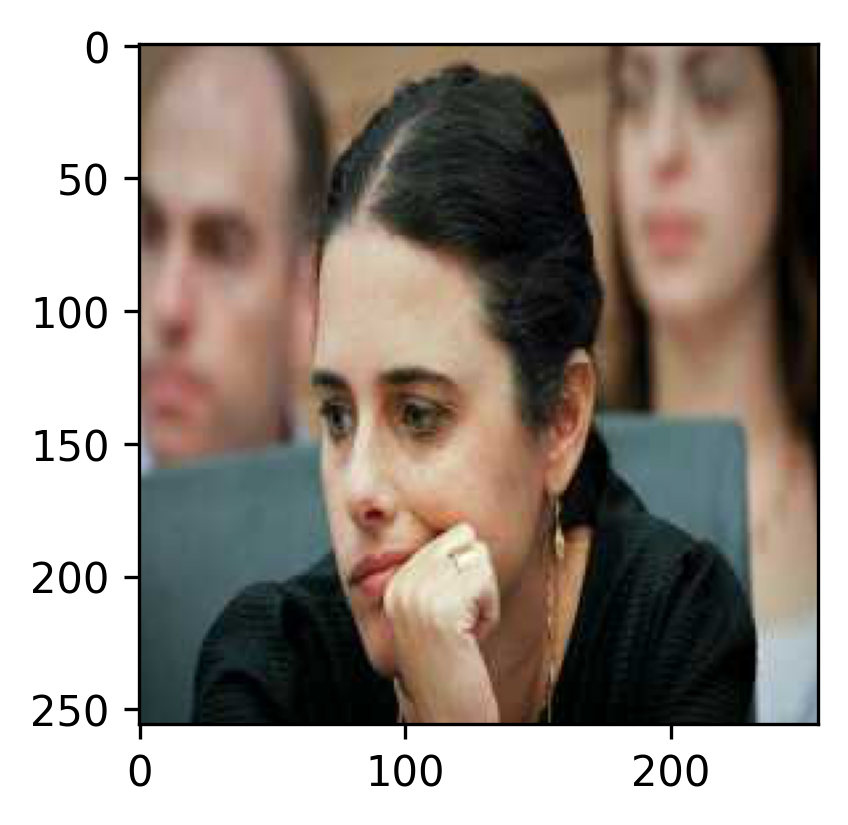



Actual: ayelet_shaked
Predicted: gideon_saar


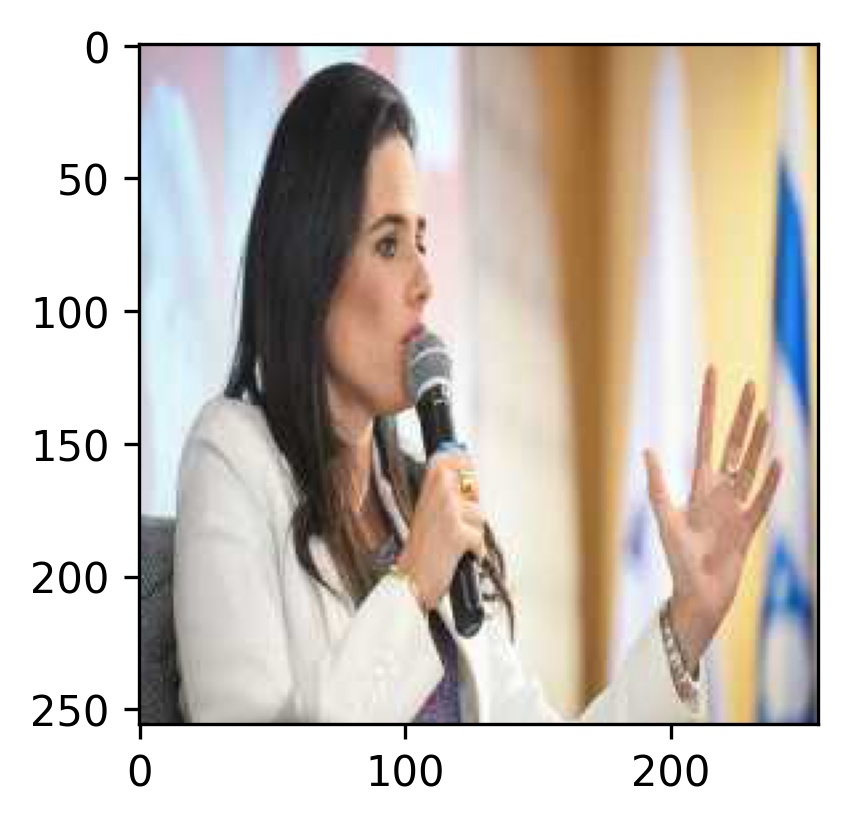


##########################
Errors for class 1 - benjamin_netanyahu
##########################



Actual: benjamin_netanyahu
Predicted: yair_lapid


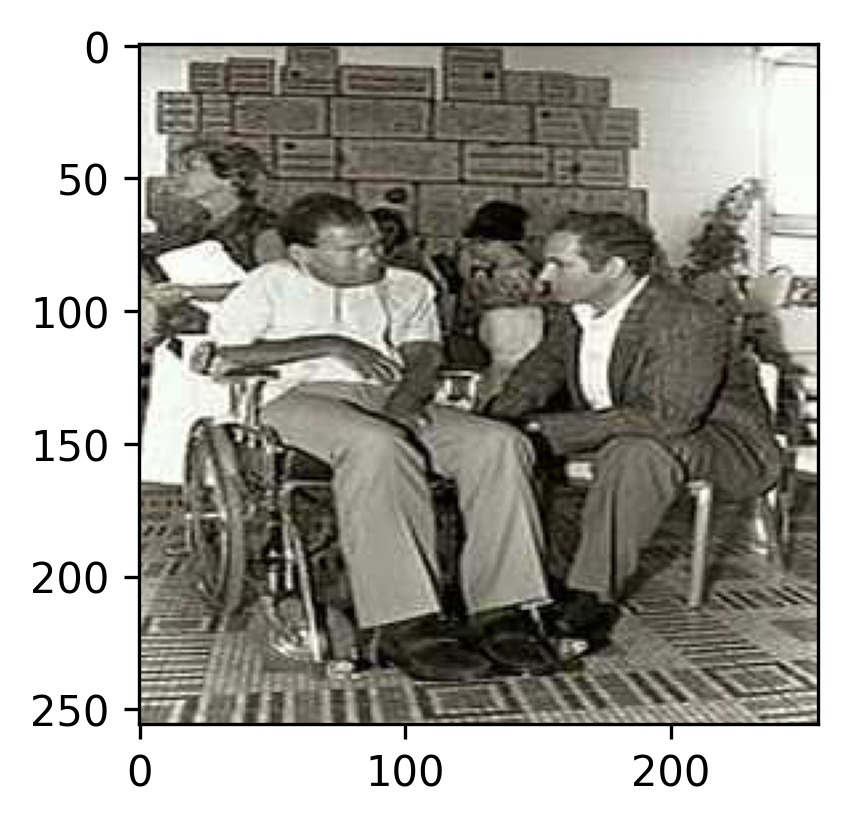



Actual: benjamin_netanyahu
Predicted: ofir_akunis


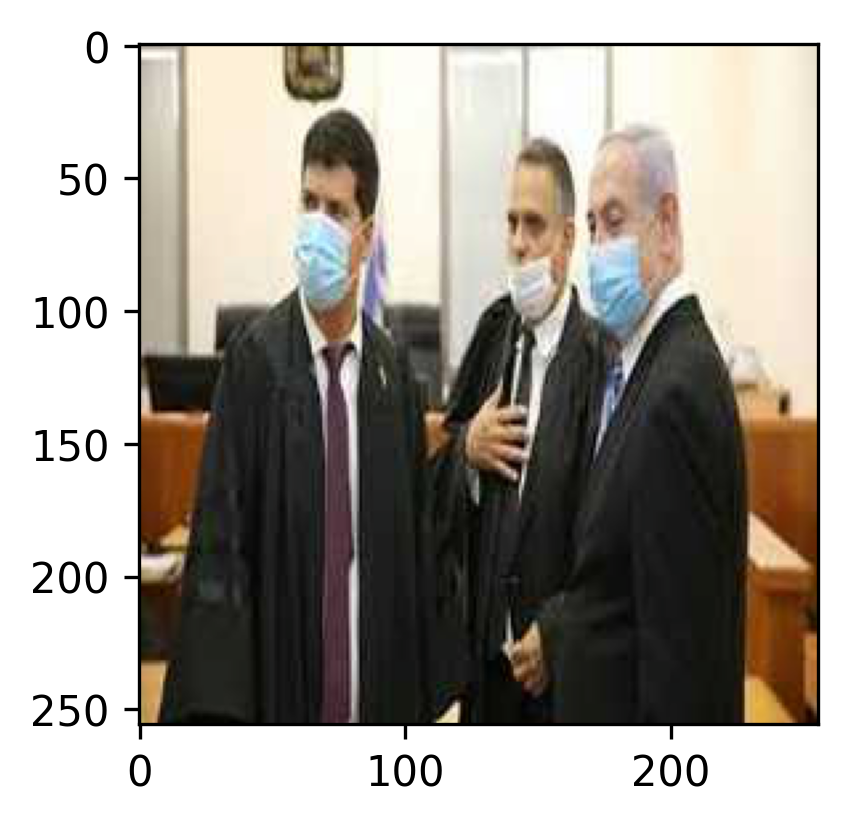



Actual: benjamin_netanyahu
Predicted: naftali_bennett


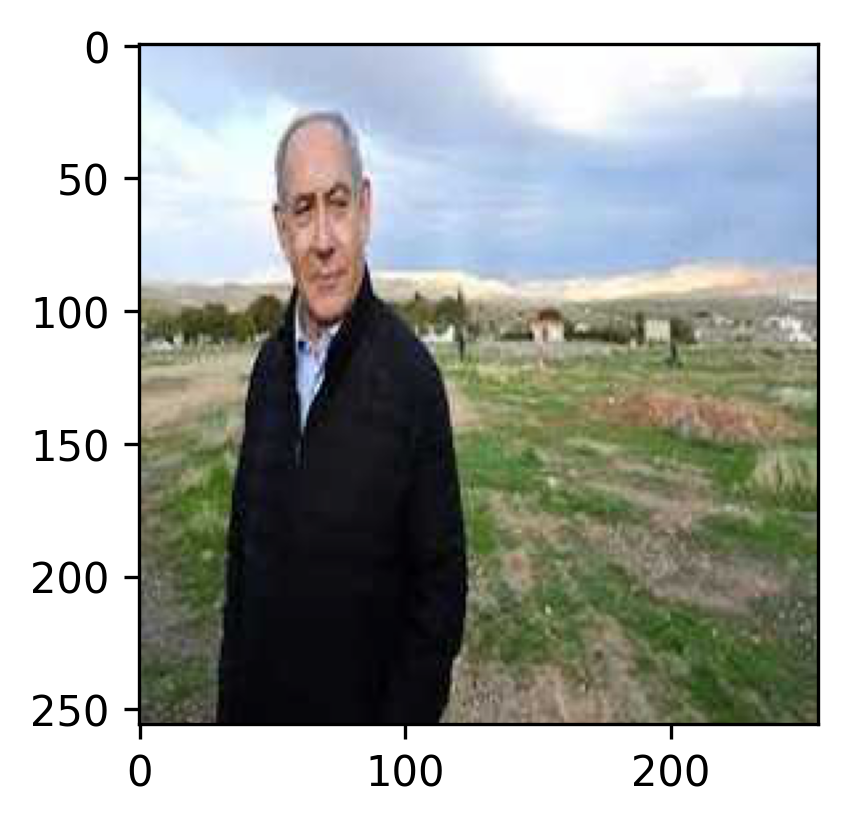



Actual: benjamin_netanyahu
Predicted: benny_gantz


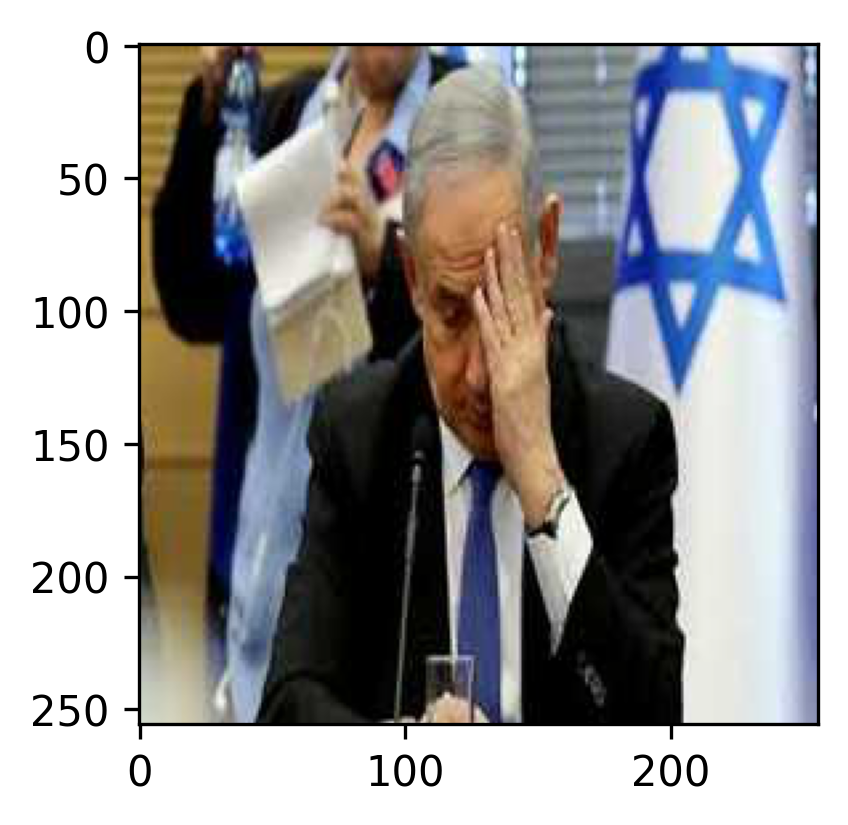



Actual: benjamin_netanyahu
Predicted: danny_danon


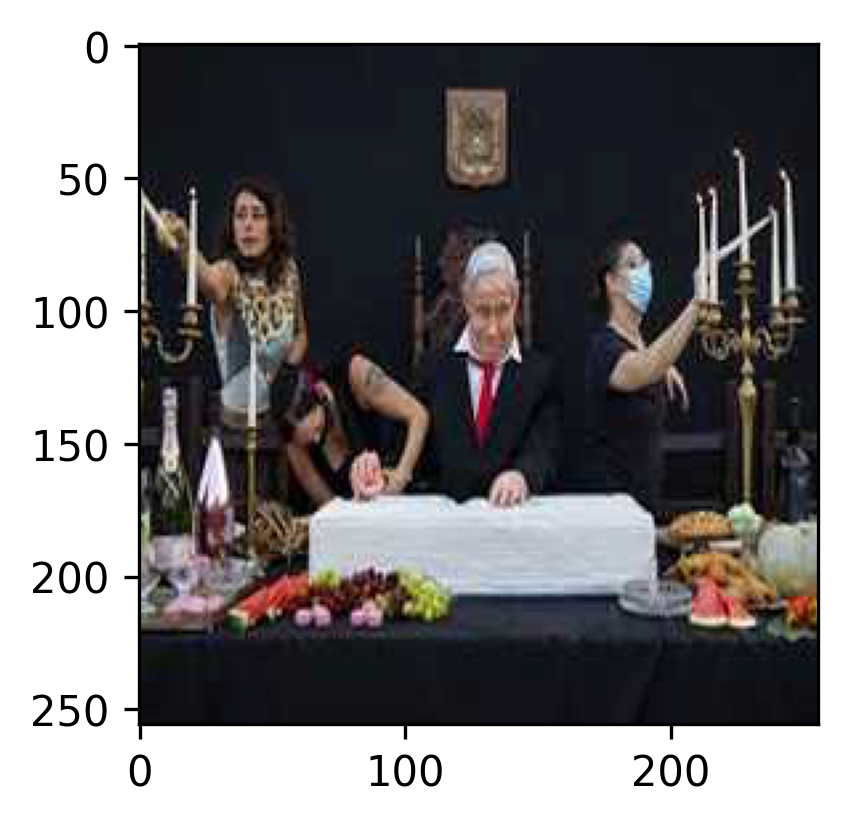



Actual: benjamin_netanyahu
Predicted: yair_lapid


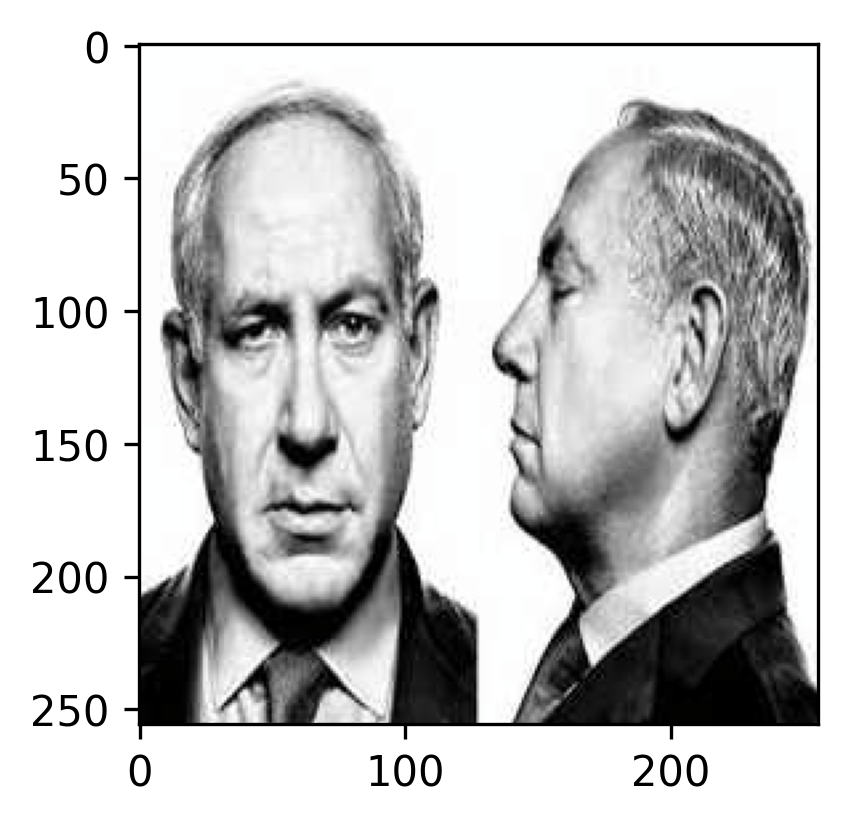



Actual: benjamin_netanyahu
Predicted: kostya_kilimnik


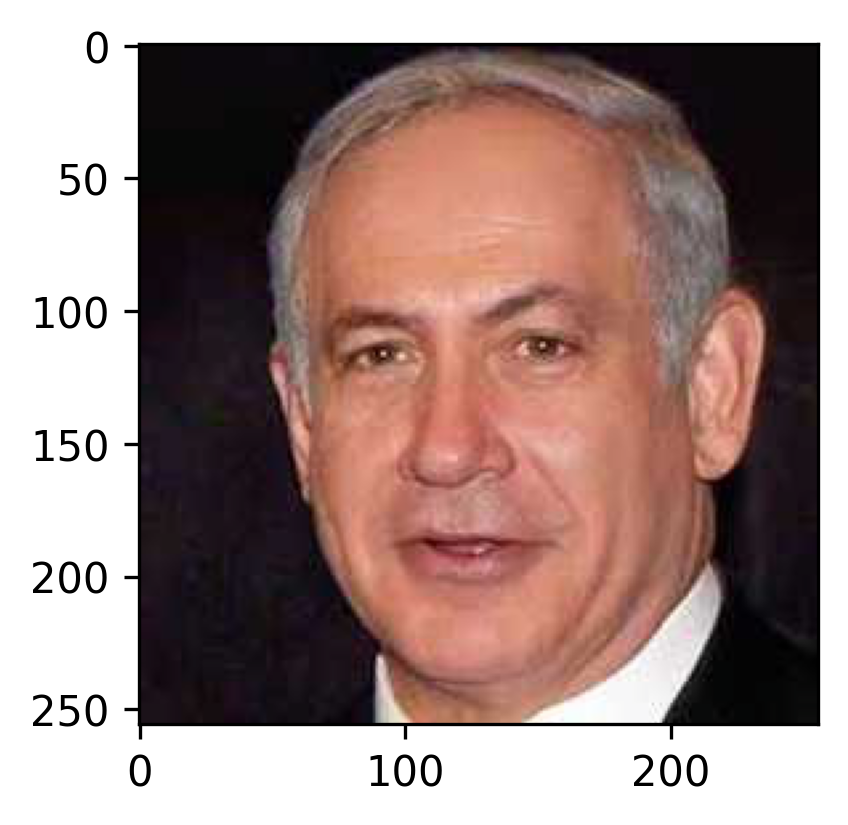


##########################
Errors for class 2 - benny_gantz
##########################



Actual: benny_gantz
Predicted: gideon_saar


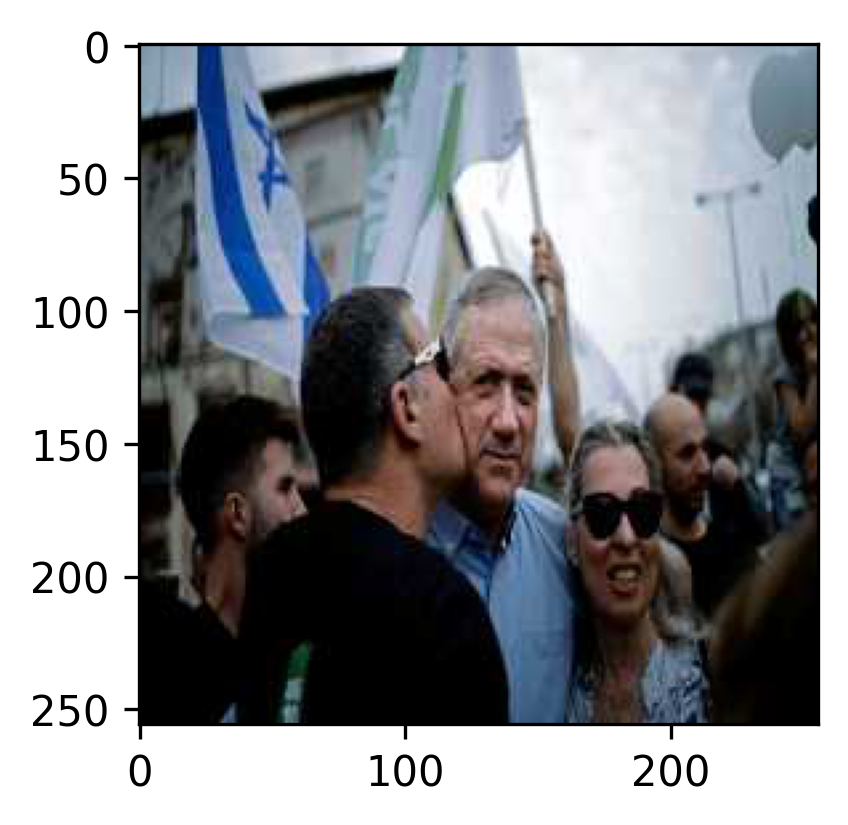



Actual: benny_gantz
Predicted: benjamin_netanyahu


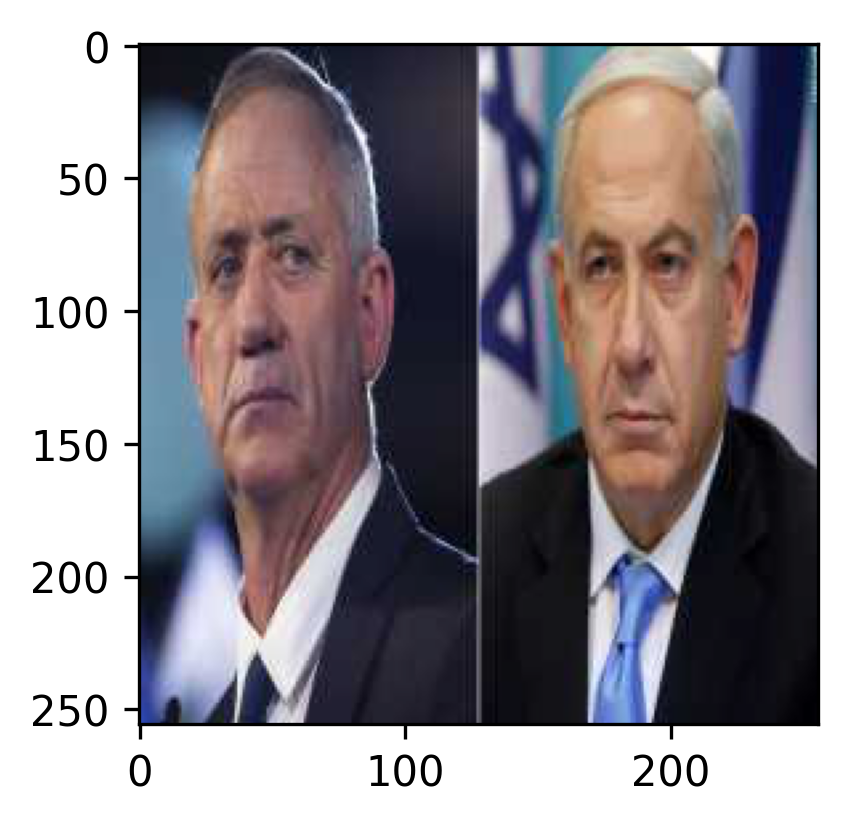



Actual: benny_gantz
Predicted: yair_lapid


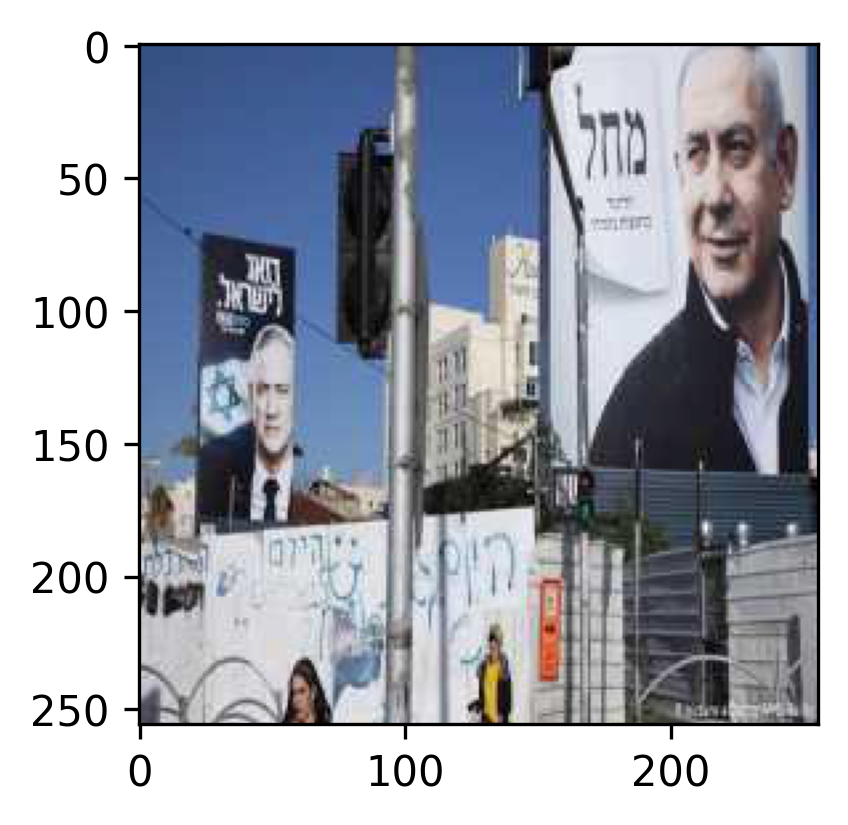



Actual: benny_gantz
Predicted: naftali_bennett


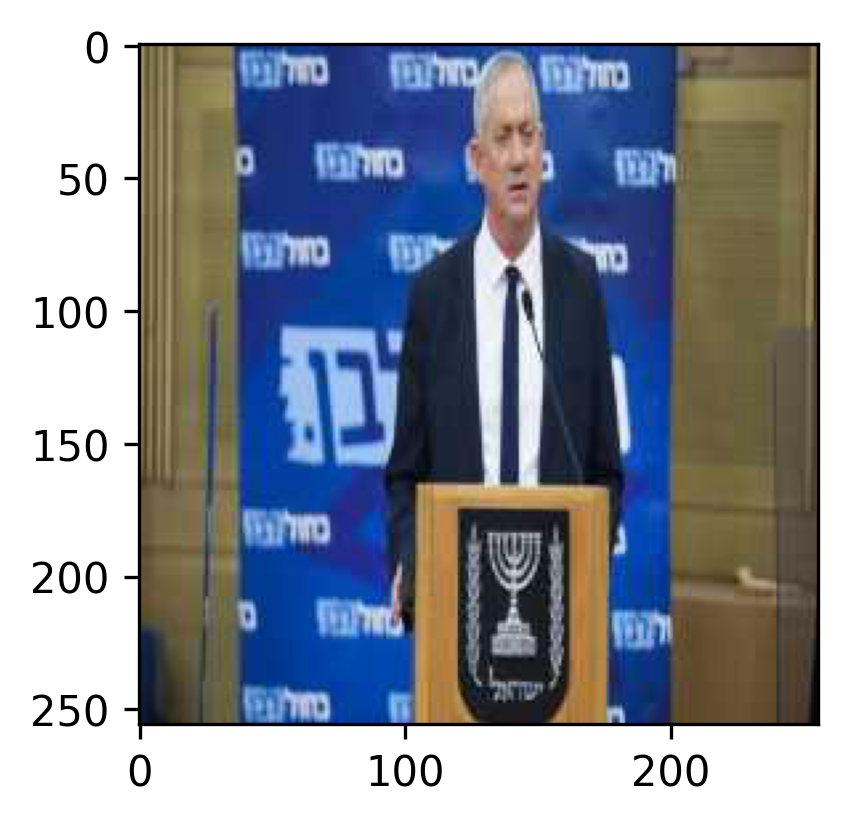



Actual: benny_gantz
Predicted: benjamin_netanyahu


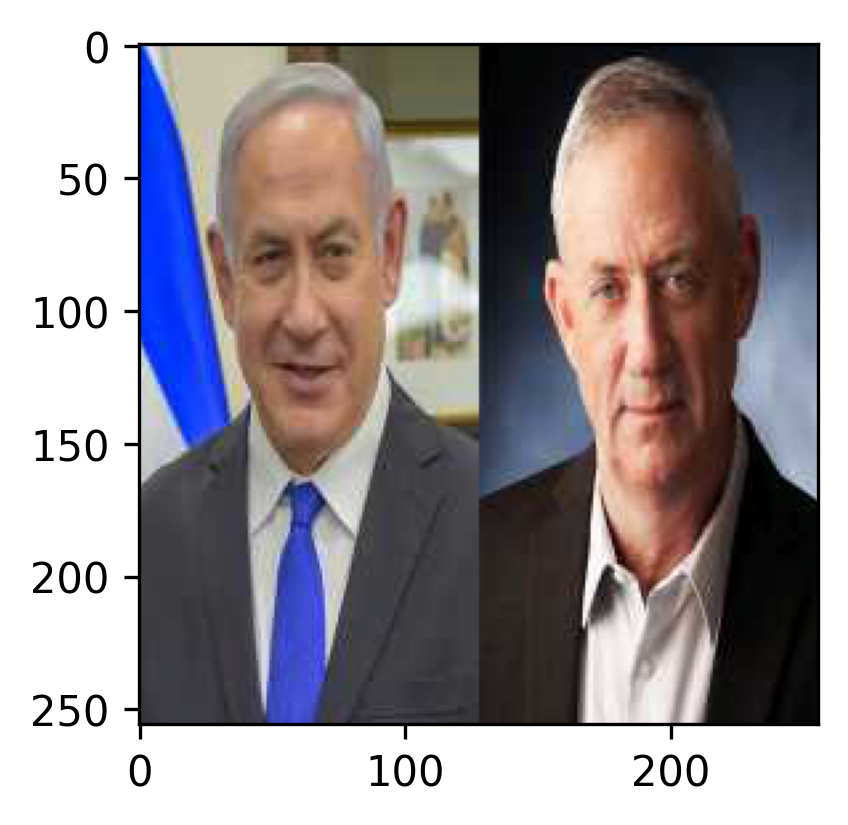



Actual: benny_gantz
Predicted: naftali_bennett


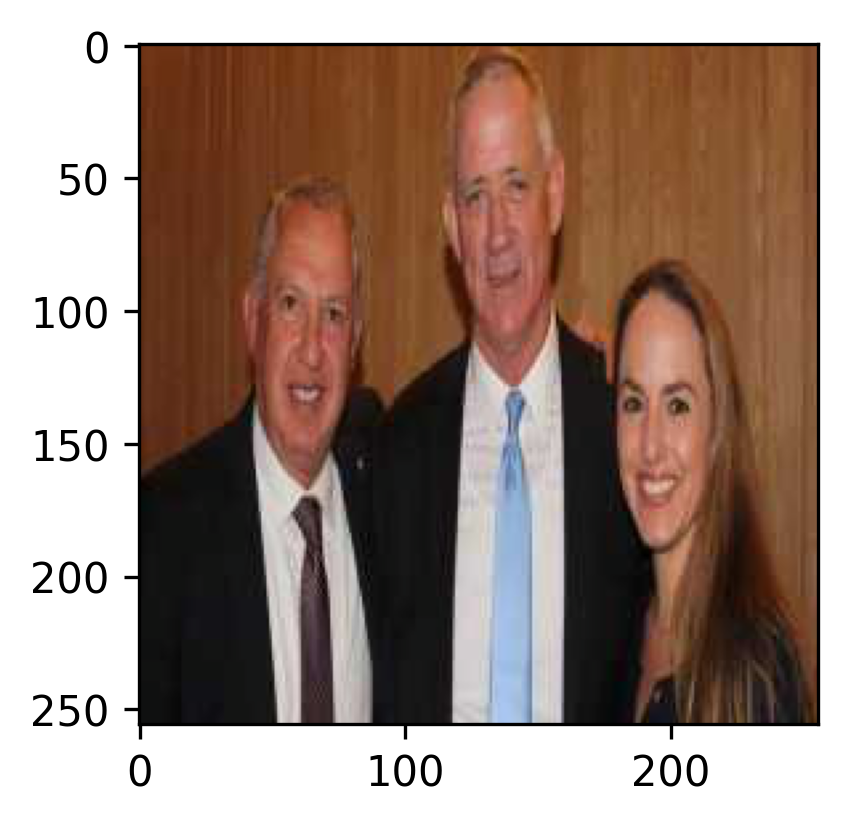



Actual: benny_gantz
Predicted: benjamin_netanyahu


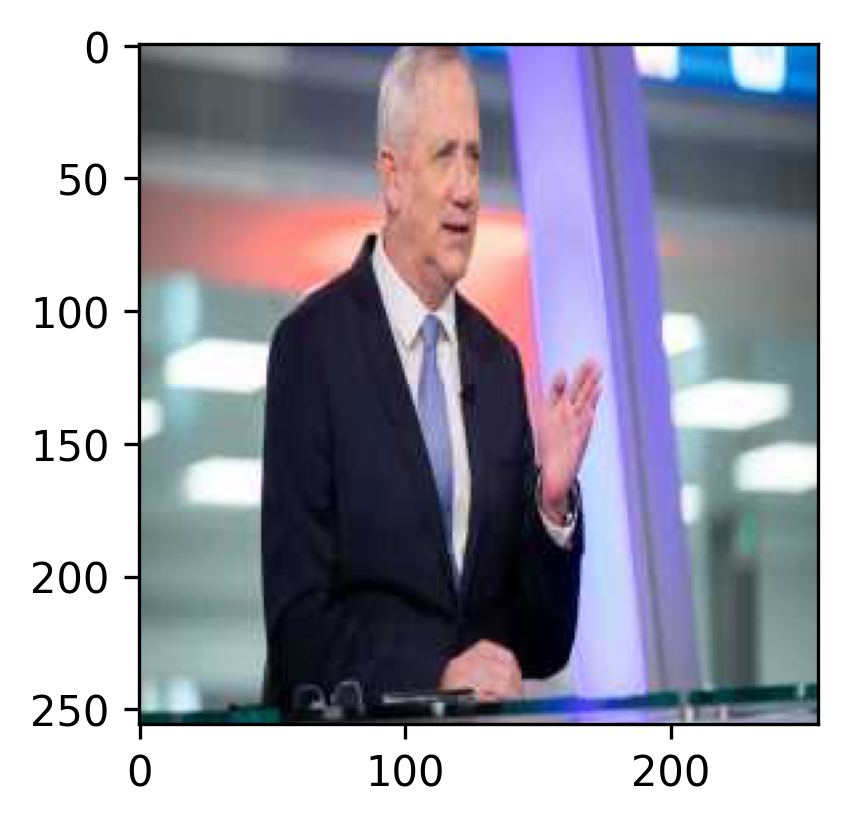



Actual: benny_gantz
Predicted: benjamin_netanyahu


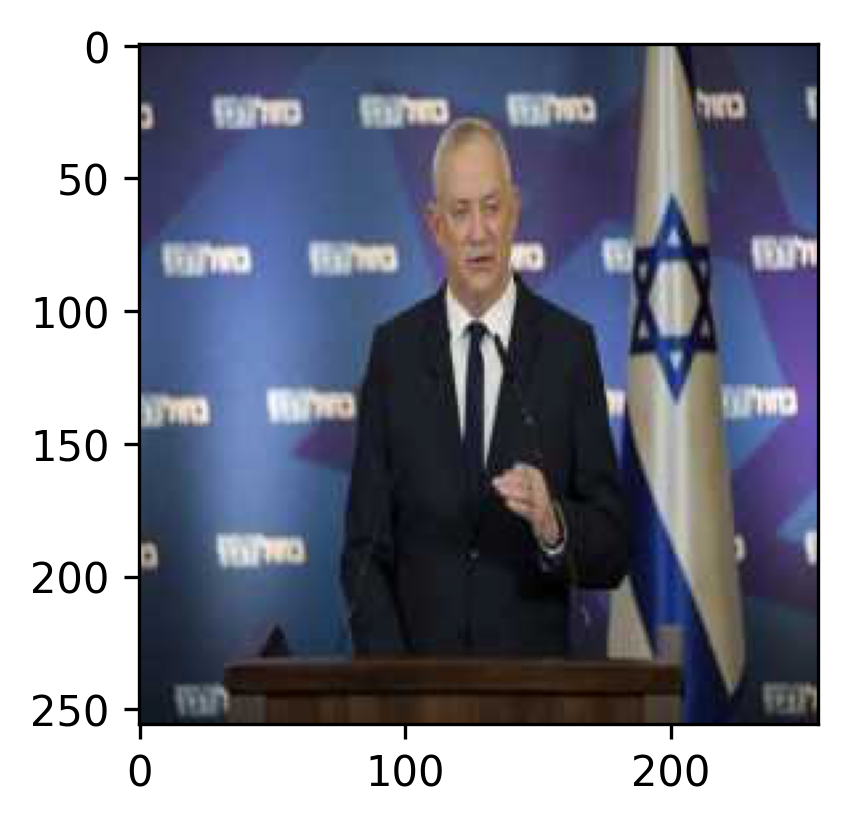



Actual: benny_gantz
Predicted: gideon_saar


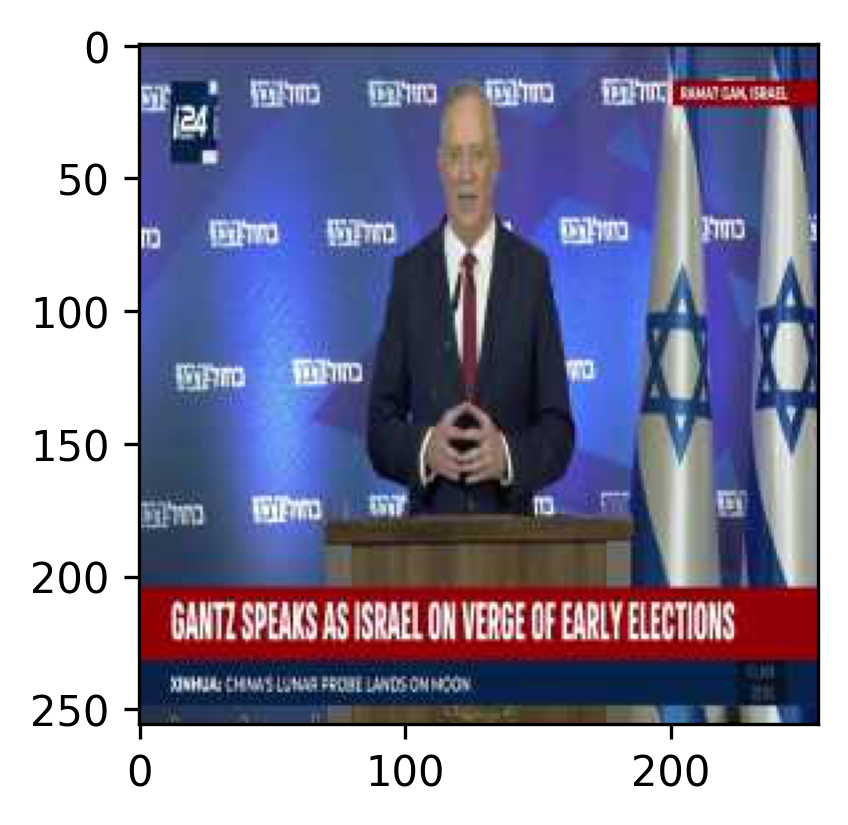



Actual: benny_gantz
Predicted: benjamin_netanyahu


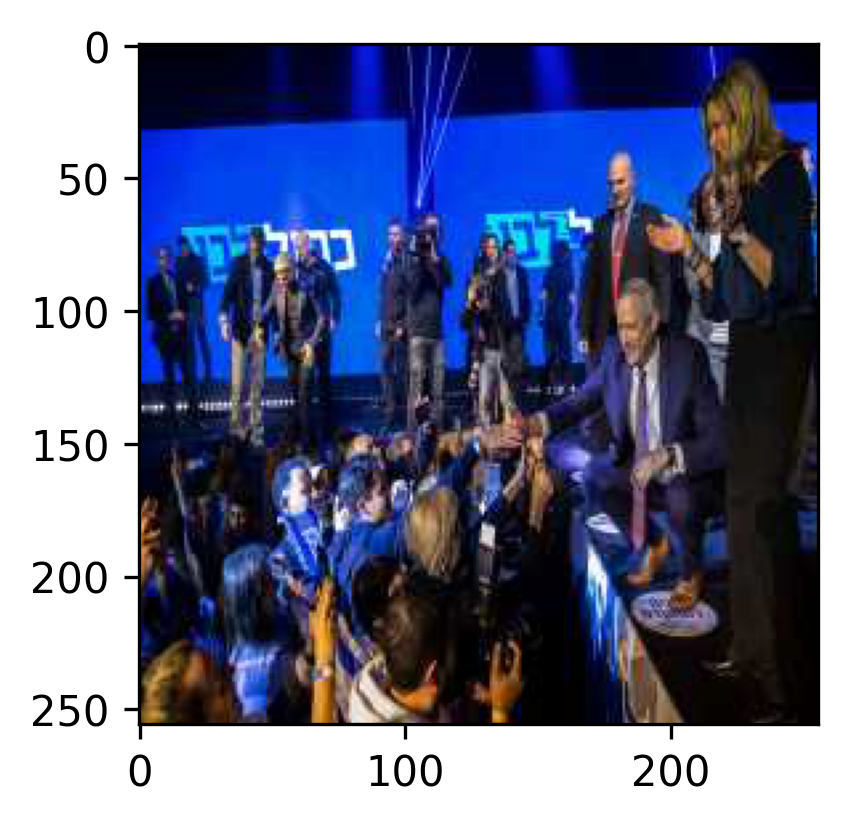


##########################
Errors for class 3 - danny_danon
##########################



Actual: danny_danon
Predicted: ofir_akunis


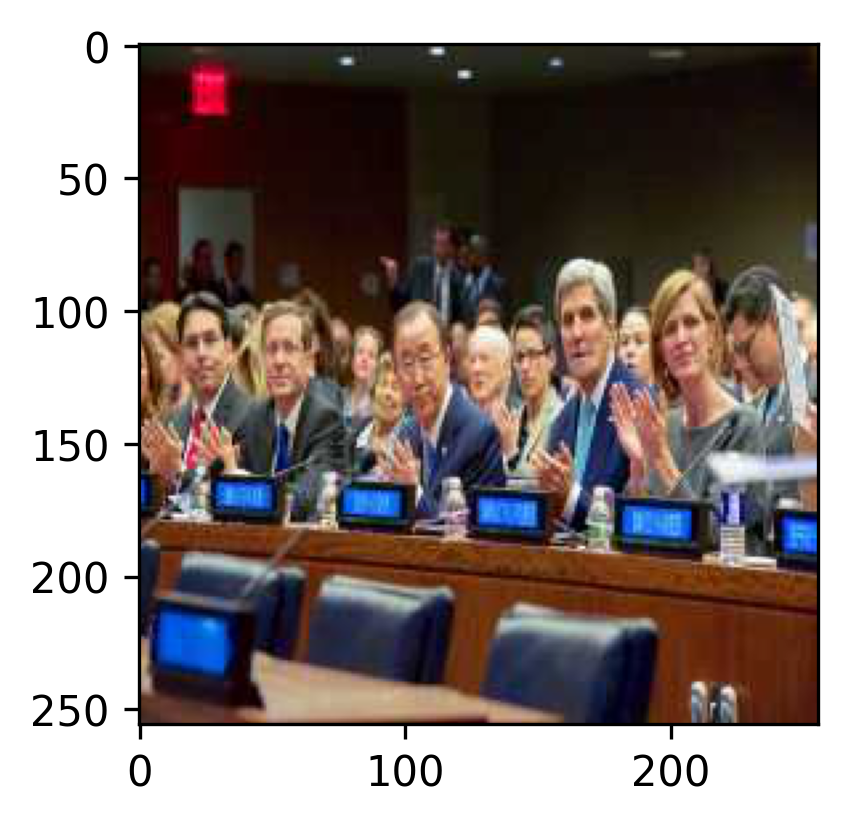



Actual: danny_danon
Predicted: ayelet_shaked


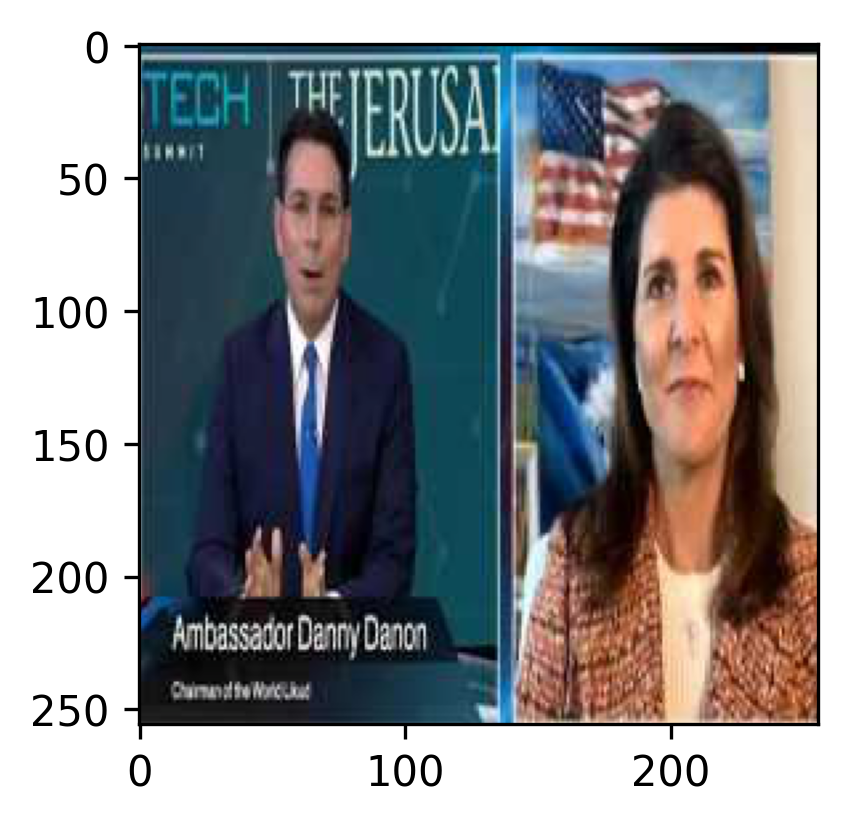



Actual: danny_danon
Predicted: yair_lapid


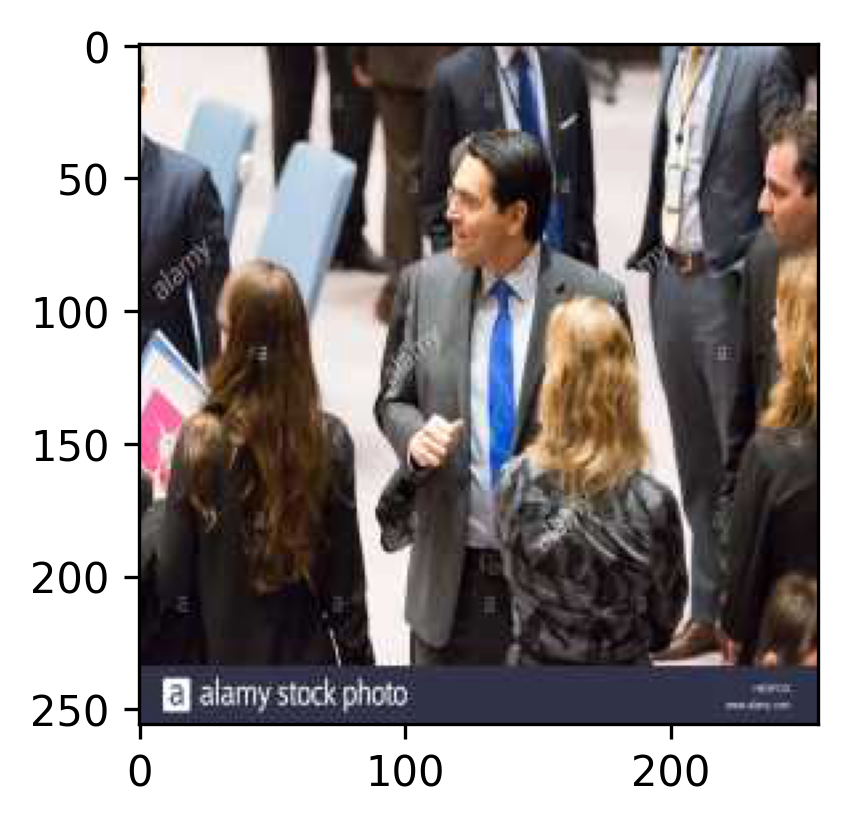


##########################
Errors for class 4 - gideon_saar
##########################



Actual: gideon_saar
Predicted: yair_lapid


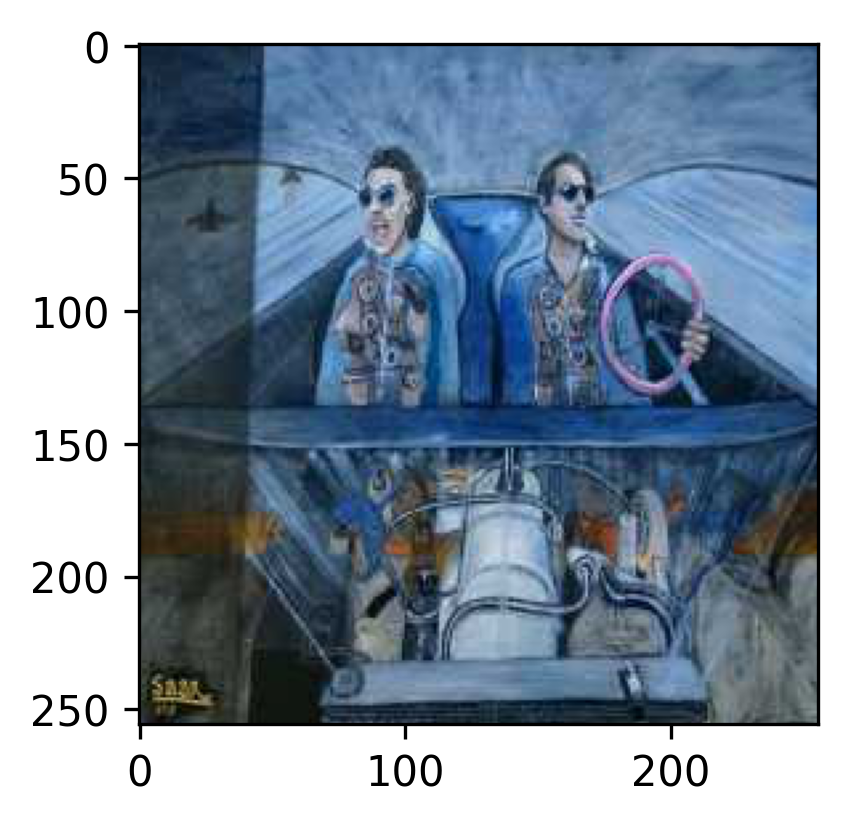



Actual: gideon_saar
Predicted: danny_danon


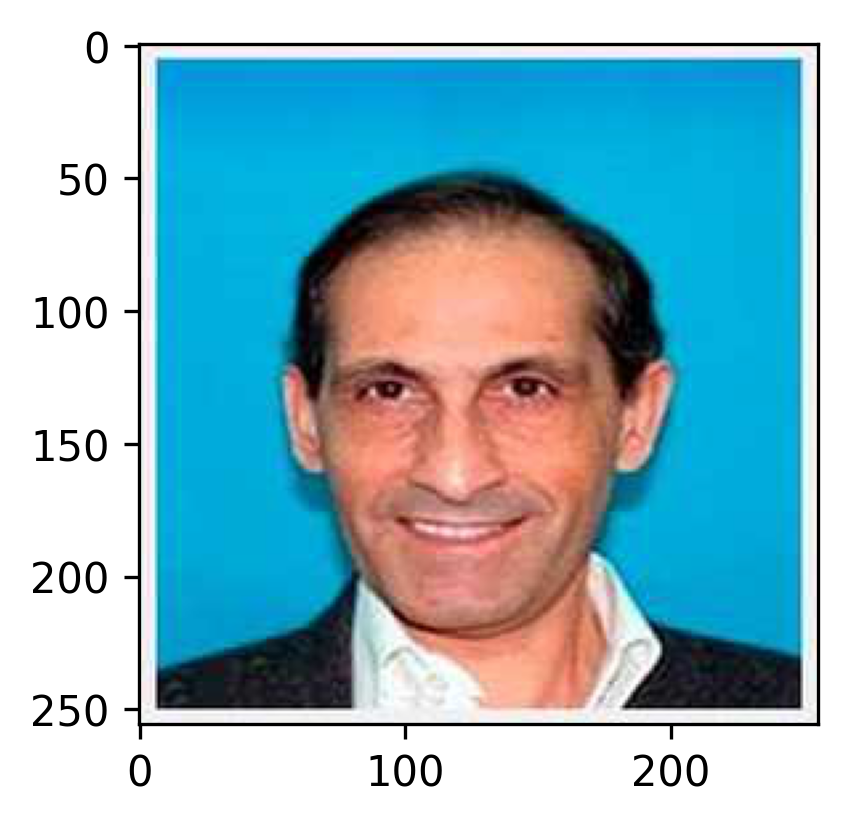



Actual: gideon_saar
Predicted: benjamin_netanyahu


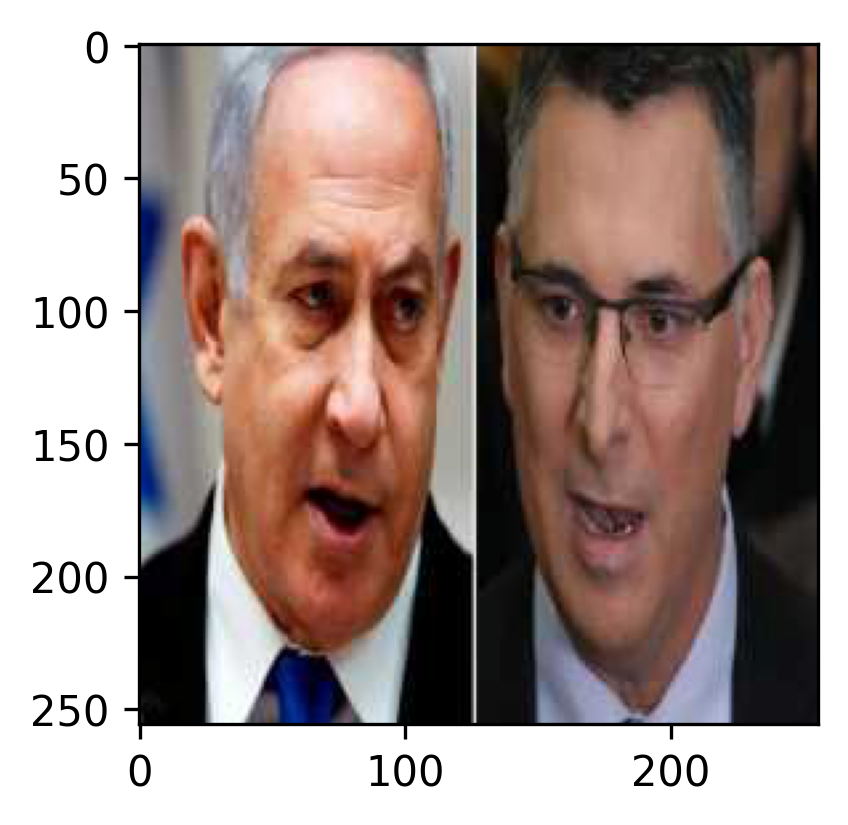



Actual: gideon_saar
Predicted: benjamin_netanyahu


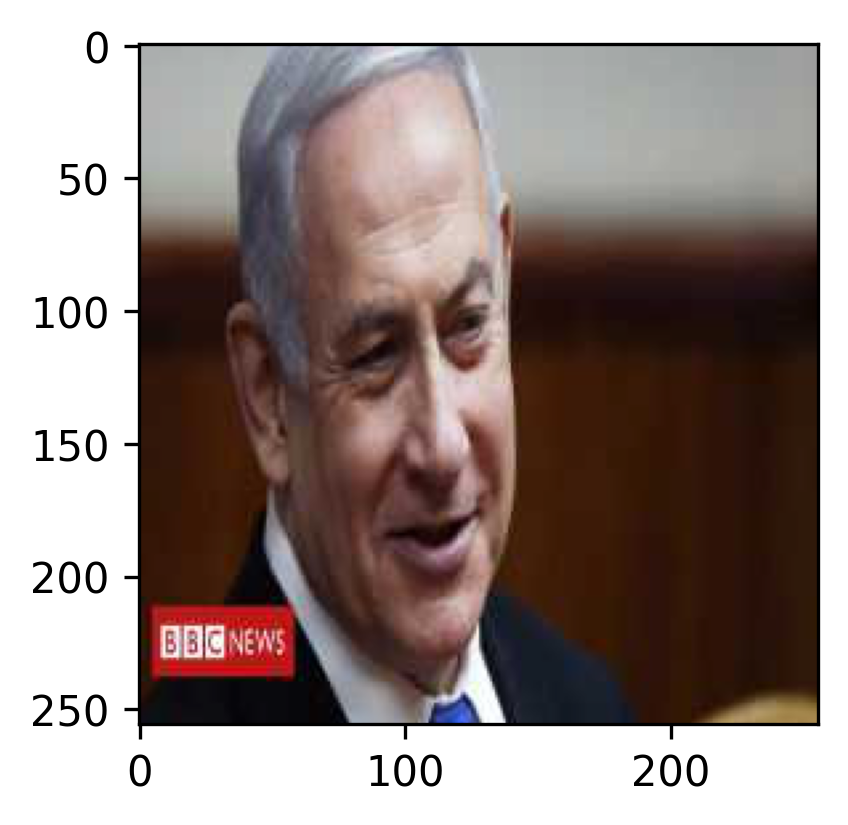


##########################
Errors for class 5 - kostya_kilimnik
##########################



Actual: kostya_kilimnik
Predicted: gideon_saar


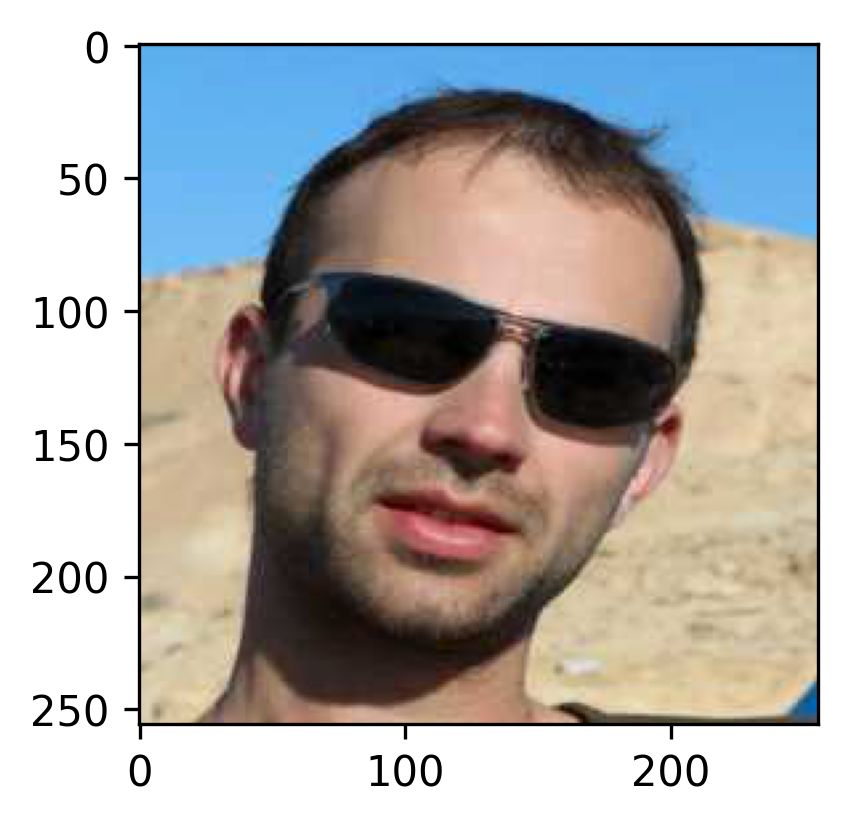


##########################
Errors for class 6 - naftali_bennett
##########################



Actual: naftali_bennett
Predicted: ayelet_shaked


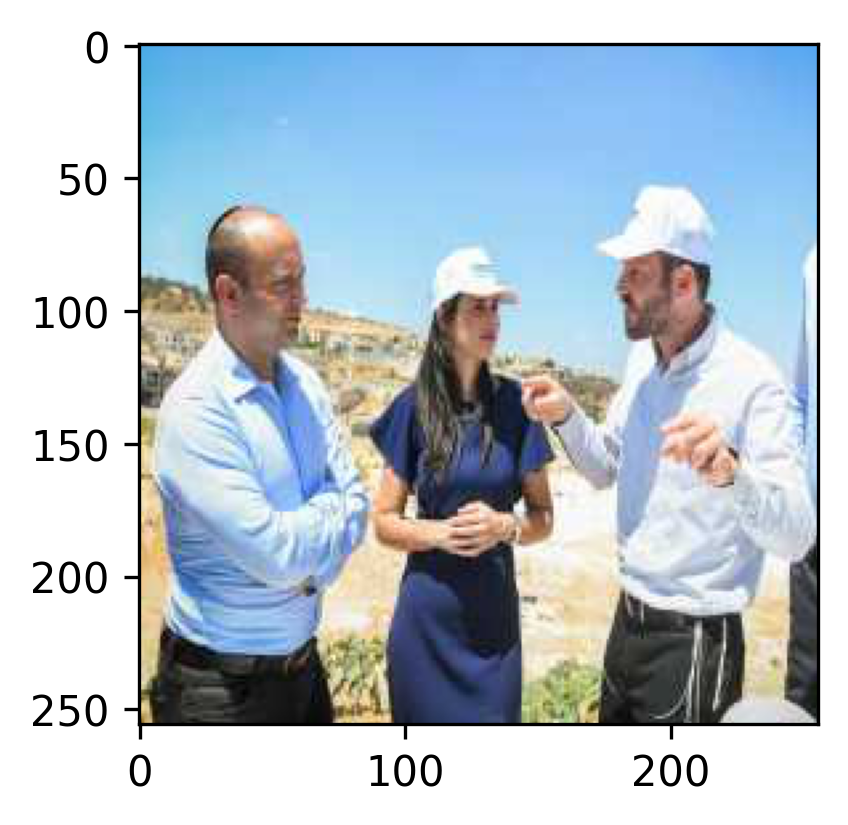



Actual: naftali_bennett
Predicted: benjamin_netanyahu


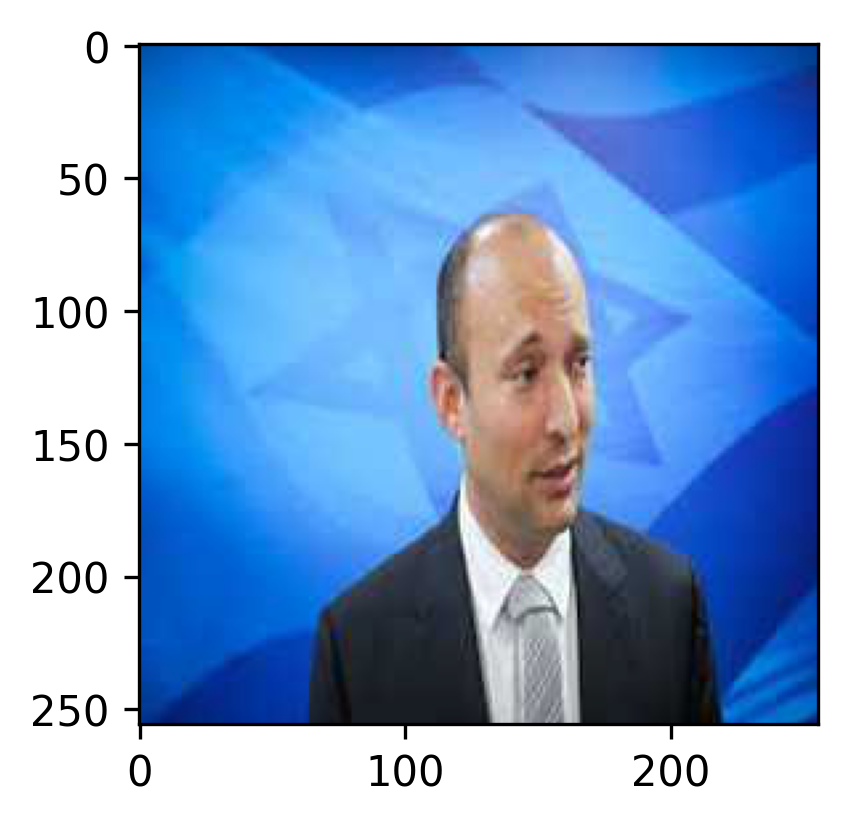



Actual: naftali_bennett
Predicted: benny_gantz


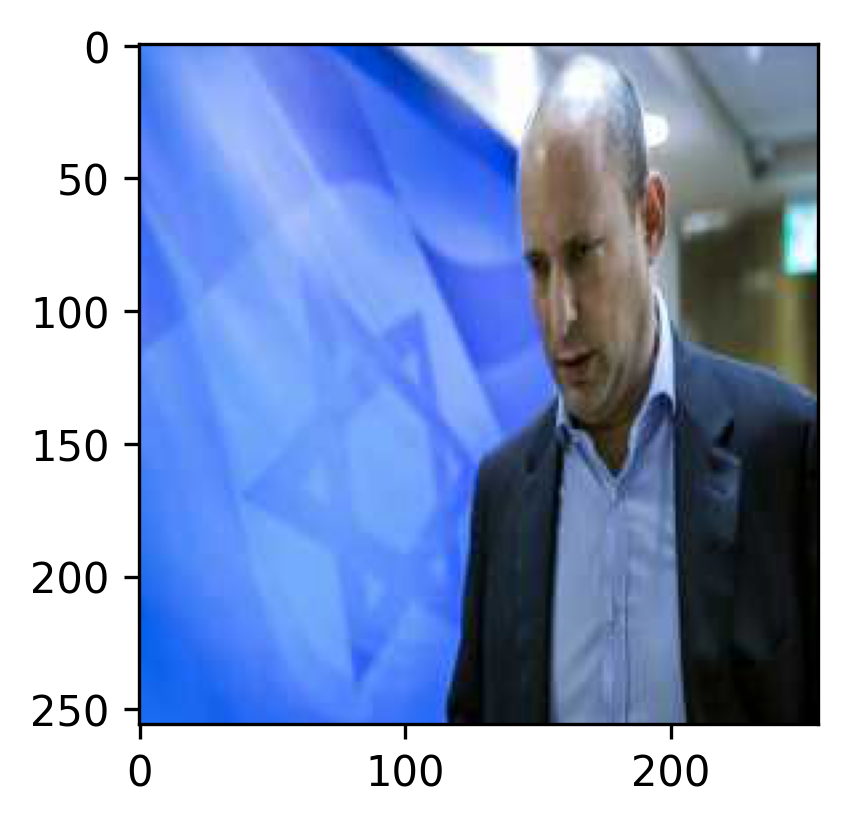



Actual: naftali_bennett
Predicted: ayelet_shaked


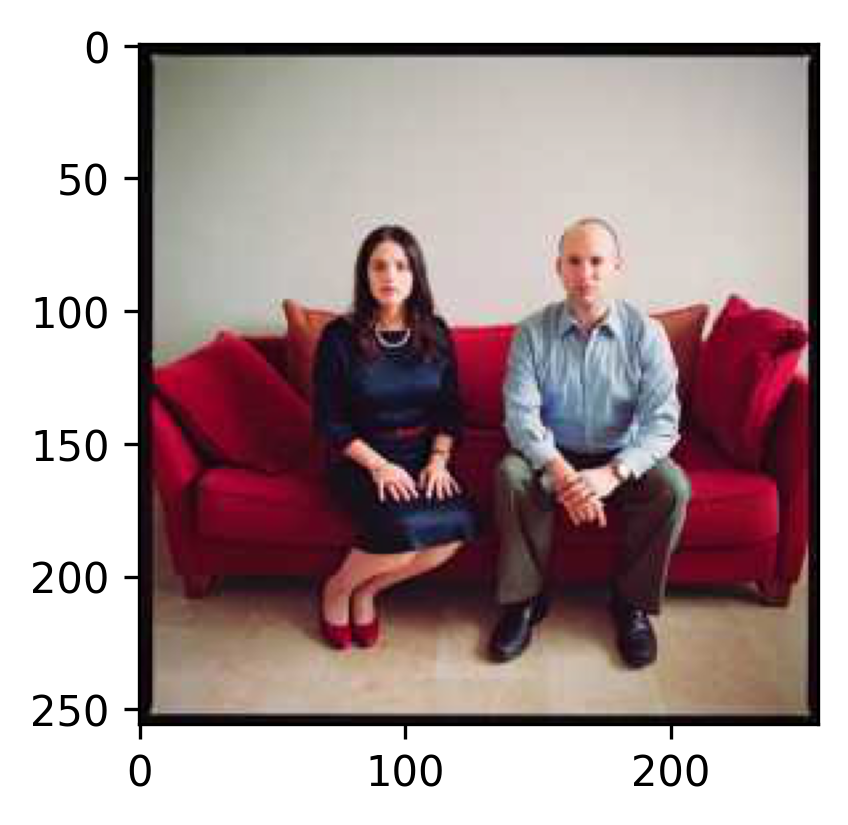



Actual: naftali_bennett
Predicted: benjamin_netanyahu


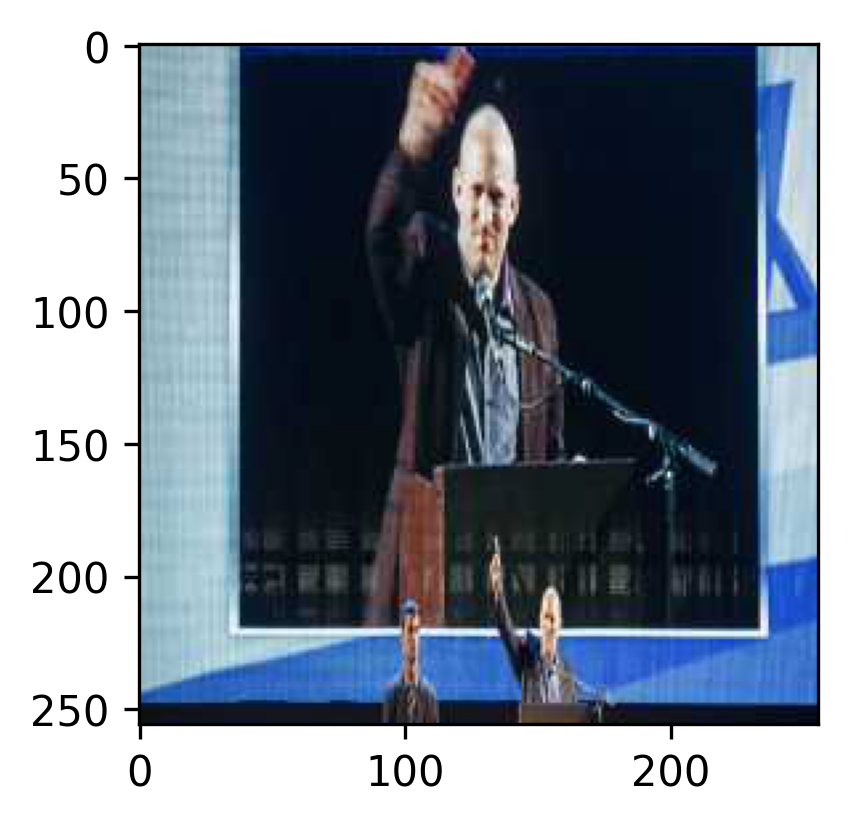



Actual: naftali_bennett
Predicted: benjamin_netanyahu


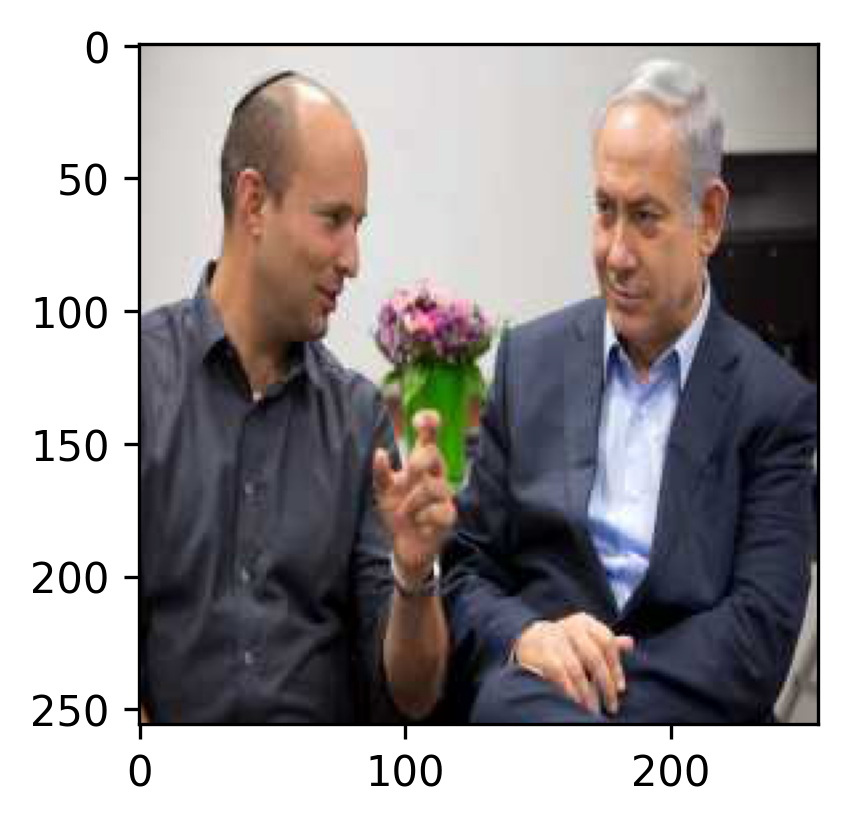



Actual: naftali_bennett
Predicted: ayelet_shaked


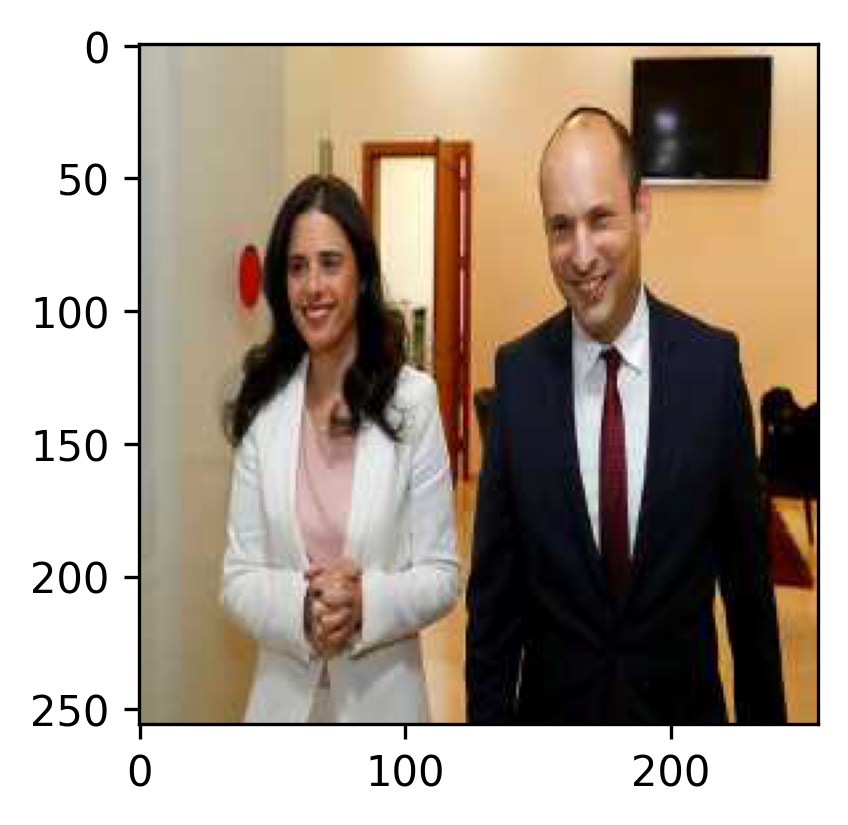



Actual: naftali_bennett
Predicted: kostya_kilimnik


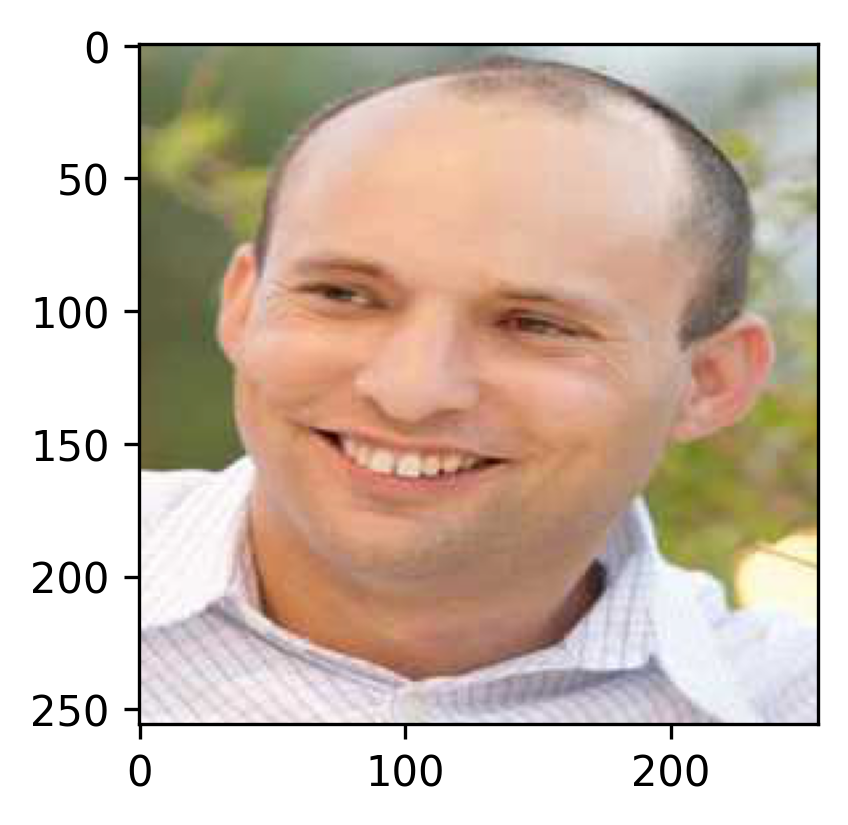


##########################
Errors for class 7 - ofir_akunis
##########################



Actual: ofir_akunis
Predicted: naftali_bennett


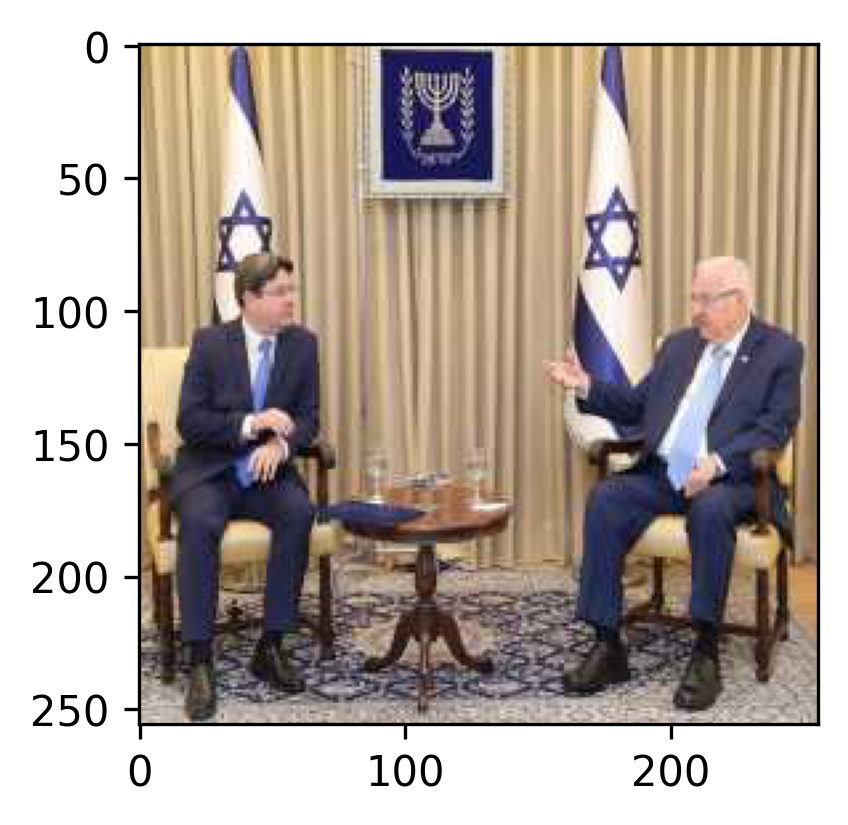



Actual: ofir_akunis
Predicted: benjamin_netanyahu


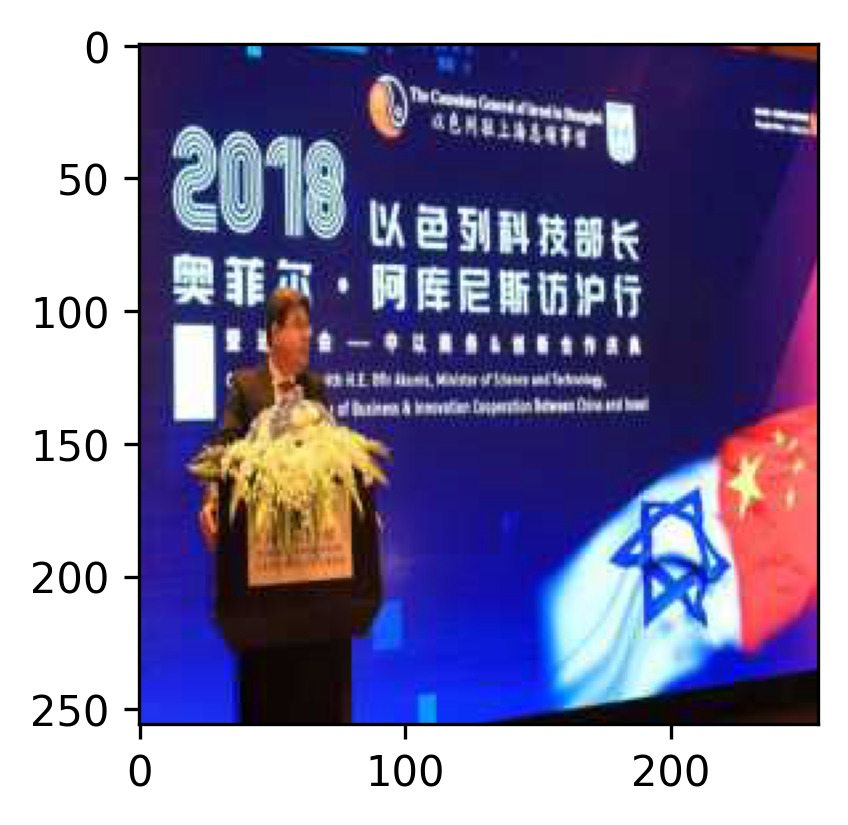


##########################
Errors for class 8 - yair_lapid
##########################



Actual: yair_lapid
Predicted: benjamin_netanyahu


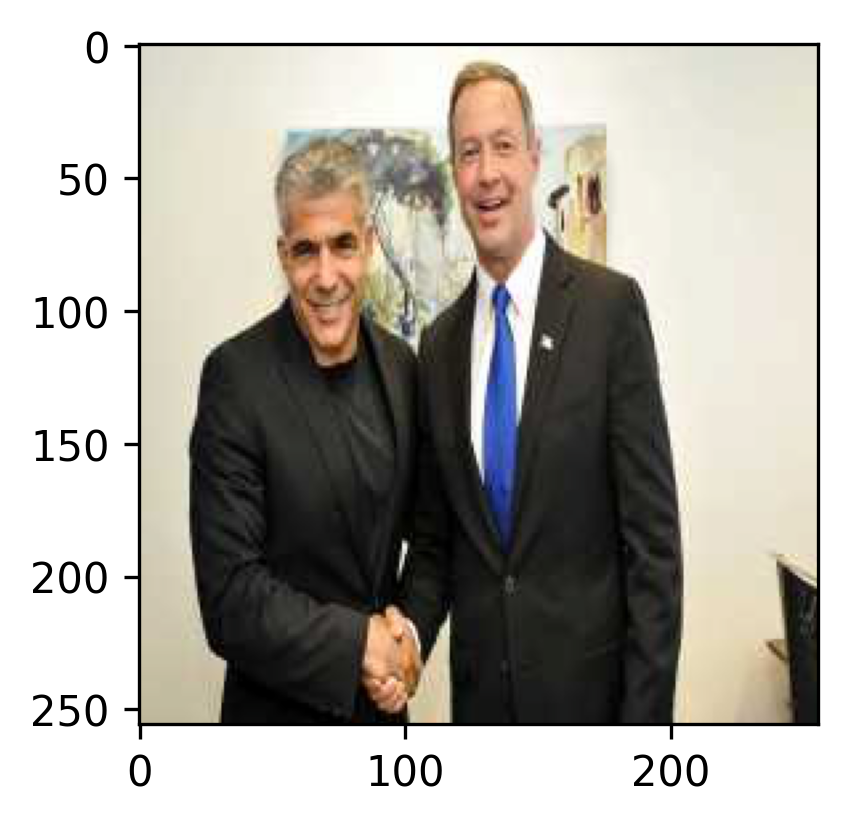



Actual: yair_lapid
Predicted: ofir_akunis


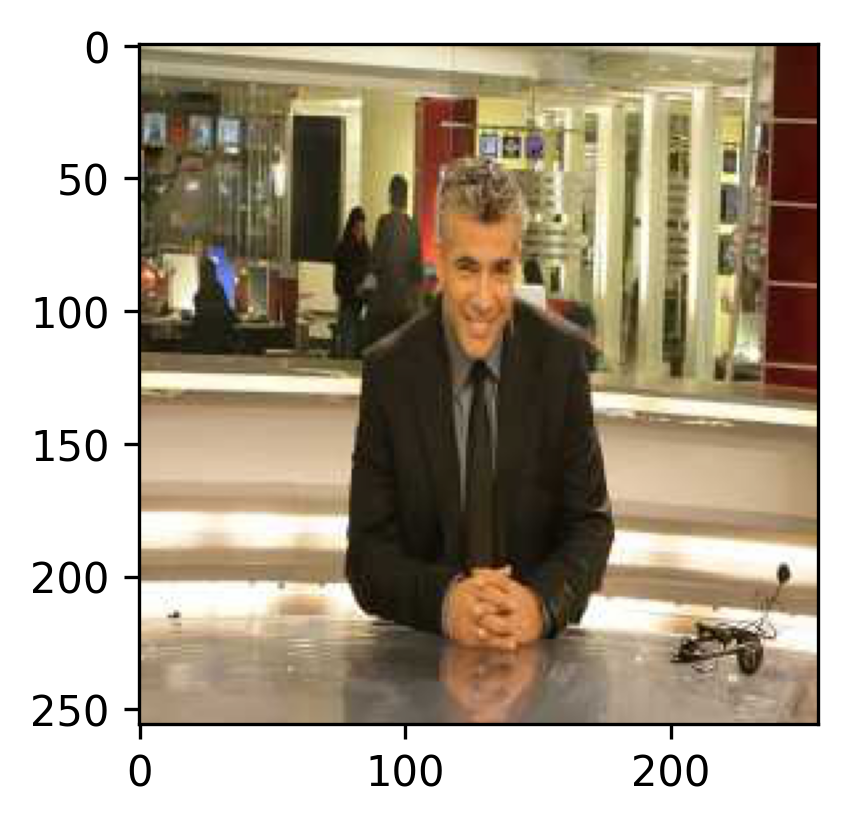

In [ ]:
def imshow_v2(inp, title=None):
    """Imshow for numpy."""
    inp = inp.transpose((1, 2, 0))
    mean = np.array(means)
    std = np.array(stds)
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    fig = plt.figure(figsize=(5,3), dpi=300)
    plt.imshow(inp)
    if title is not None:
       plt.title(title, fontsize=5)
    plt.pause(0.001)  # pause a bit so that plots are updated

i=0
for c in class_names:  
  class_inputs = full_inputs[full_labels==i]
  class_preds = full_preds[full_labels==i]
  class_errors_idx = np.where(full_labels[full_labels==i] != full_preds[full_labels==i])

  print(f"\n##########################\nErrors for class {i} - {c}\n##########################\n")

  for err_idx in class_errors_idx[0]:
      pred = class_preds[err_idx]
      img = class_inputs[err_idx]
      # print(class_errors_idx)
      # print(err_idx)
      
      print(f"\n\nActual: {c}\nPredicted: {class_names[pred]}")
      imshow_v2(img)

  i+=1

#### Do you spot any issue or pattern?
Definitely:

1. It seems like we have a lot of samples of two or more people in the same picture which can cause mistakes.
2. We have a lot of pictures with multiple politicians that we are trying to class in the same photo! As we decided to solve this as a single label classification problem, such samples are a multi-label problem, we are just causing damage to our model evaluation.
3. It seems that we make mistakes in photos with a large flag / multiple flags (classifying photos with such object as Benjamin Netanyahu / Gantz), this probably means that we have a lot of photos of them with flags in the train set (which makes sense as they were running for prime minister position) - We need to limit such photos in the train set / find multiple photos of the other politicians with flags and add them to the train set.
4. Covid masks mistakes - A lot of them as well, probably missing in the training set (or potentially we have a lot of masked picture of only some of the politicians)
5. Objects / hands are hiding parts of the face or the mouth - this also seems to repeat in multiple classification errors (similar reasons to masks).


#### Try to see if you can improve the performance of the model following your insights.

- I've duplicated the israeli_politicians folder to israeli_politions_v2.
- Removed images of 2 or more people that we've found in the error analysis stage
- I also noticed in the process of manual labelling that we had mistakes in the train set (e.g. Benjamin Netanyahu's photos inside Gideon Saars training set photos / photos of other unrelated people labelled as the politicians), I removed such mistakes (both in the training and validation set)
- I also noticed duplicates of photos and leakage (same photos in train and validation set for the same politician - I tried to remove these when possible).

In [ ]:
with ZipFile('./data/israeli_politicians_v2.zip', 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall(path='./data/israeli_politicians_v2/')


In [ ]:

# Define transformations that resize the images to 256x256, and normalize them. 
# The means and standard deviations of each channel are the values used for normalization in ImageNet
means = [0.485, 0.456, 0.406]
stds = [0.229, 0.224, 0.225]

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

data_dir = r'./data/israeli_politicians_v2/'

# Create a dictionary of train and val datasets from images in folders
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}

dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
print('dataset_sizes: ', dataset_sizes)

class_names = image_datasets['train'].classes
print('class_names:', class_names)


dataloaders = {
    'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=16,
                                             shuffle=True, num_workers=4),
    'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=16,
                                          shuffle=False, num_workers=4)
  }

# Check for the availability of a GPU, and use CPU otherwise
# If you are using Google Colab, be sure to change your runtime environment to GPU first.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

train_dataloader = dataloaders['train']


# Get a batch of training data - the data loader is a generator
inputs, classes = next(iter(dataloaders['train']))

# We load a pretrain model with its weights. Alternatively, one might want to only load the model architecture.
model = models.vgg16(pretrained=True)

# This code should output the number of input neurons to the final layer. We'll use it to create a new layer instead of it.
last_layer = list(model.children())[-1]
if hasattr(last_layer, 'in_features'):
  num_ftrs = last_layer.in_features
else:
  num_ftrs = last_layer[-1].in_features

model.classifier[6] = nn.Linear(in_features=4096, out_features=9)

# If a GPU is available, make the model use it
model = model.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterion = nn.CrossEntropyLoss()

# Use Stochastic Gradient Descent as the optimizer, with a learning rate of 0.001 and momentum
# Momentum simulates the corase of a heavy ball, and keeps moving in the direction of the previous gradient along with the new gradient. 
# Empirically it is known to show better convergence. We will learn about it in future lessons.
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

num_epochs = 10



dataset_sizes:  {'train': 696, 'val': 167}
class_names: ['ayelet_shaked', 'benjamin_netanyahu', 'benny_gantz', 'danny_danon', 'gideon_saar', 'kostya_kilimnik', 'naftali_bennett', 'ofir_akunis', 'yair_lapid']


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

In [ ]:
model = train_model(model, 
                    dataloaders,
                    criterion, 
                    optimizer_ft, 
                    exp_lr_scheduler,
                    num_epochs=num_epochs)

Epoch 0/9
----------
train Loss: 1.8560 Acc: 0.3204
val Loss: 1.4411 Acc: 0.4910

Epoch 1/9
----------
train Loss: 1.0223 Acc: 0.6365
val Loss: 0.8346 Acc: 0.7006

Epoch 2/9
----------
train Loss: 0.4834 Acc: 0.8348
val Loss: 0.8955 Acc: 0.6886

Epoch 3/9
----------
train Loss: 0.2650 Acc: 0.9066
val Loss: 0.8961 Acc: 0.7126

Epoch 4/9
----------
train Loss: 0.1306 Acc: 0.9583
val Loss: 1.0000 Acc: 0.7605

Epoch 5/9
----------
train Loss: 0.1052 Acc: 0.9612
val Loss: 0.8640 Acc: 0.7725

Epoch 6/9
----------
train Loss: 0.1326 Acc: 0.9626
val Loss: 0.6316 Acc: 0.7904

Epoch 7/9
----------
train Loss: 0.0380 Acc: 0.9856
val Loss: 0.6628 Acc: 0.8024

Epoch 8/9
----------
train Loss: 0.0178 Acc: 0.9957
val Loss: 0.6790 Acc: 0.8084

Epoch 9/9
----------
train Loss: 0.0111 Acc: 0.9986
val Loss: 0.7009 Acc: 0.8024

Training complete in 7m 36s
Best val Acc: 0.808383


We see that by cleaning the data we kept pretty much on the same performance.

1. This actually means we potentially improved, as there were a lot of falsly labelled samples in the previous model dataset that we cleaned.
2. I did not add any new samples and only deleted and cleaned a lot of the samples, I believe that a major improvement can be achieved by adding a lot of additional labelled samples (which I would have done in the next model iteration).

## Task 4: Data Augmentation
Manually labeling can be expensive, both in terms of money and of time. Data augmentations serve to increase the amount of data available for the classifier without requiring labeling more images.  

The torch vision package allows easy augmentation of images using the data transforms.  
Use and adapt the code below to try different augmentations, and discuss the results and the model improvements you got from these augmentations.

[This guide](https://www.analyticsvidhya.com/blog/2019/12/image-augmentation-deep-learning-pytorch/) might help you along the way.

In [ ]:
# Data augmentation and normalization for training
# Just normalization for validation


data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.RandomHorizontalFlip(p=0.33),
        transforms.RandomRotation(degrees=10),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

# We load a pretrain model with its weights. Alternatively, one might want to only load the model architecture.
model = models.vgg16(pretrained=True)

# This code should output the number of input neurons to the final layer. We'll use it to create a new layer instead of it.
last_layer = list(model.children())[-1]
if hasattr(last_layer, 'in_features'):
  num_ftrs = last_layer.in_features
else:
  num_ftrs = last_layer[-1].in_features

model.classifier[6] = nn.Linear(in_features=4096, out_features=9)

# If a GPU is available, make the model use it
model = model.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterion = nn.CrossEntropyLoss()

# Use Stochastic Gradient Descent as the optimizer, with a learning rate of 0.001 and momentum
# Momentum simulates the corase of a heavy ball, and keeps moving in the direction of the previous gradient along with the new gradient. 
# Empirically it is known to show better convergence. We will learn about it in future lessons.
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

num_epochs = 10

aug_model = train_model(model, 
                       dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=num_epochs)

Epoch 0/9
----------
train Loss: 1.8358 Acc: 0.3563
val Loss: 1.4208 Acc: 0.4671

Epoch 1/9
----------
train Loss: 1.0405 Acc: 0.6307
val Loss: 1.1417 Acc: 0.5988

Epoch 2/9
----------
train Loss: 0.5932 Acc: 0.8003
val Loss: 0.7687 Acc: 0.7425

Epoch 3/9
----------
train Loss: 0.3669 Acc: 0.8779
val Loss: 0.6043 Acc: 0.8144

Epoch 4/9
----------
train Loss: 0.2939 Acc: 0.9052
val Loss: 0.6419 Acc: 0.7844

Epoch 5/9
----------
train Loss: 0.3129 Acc: 0.8937
val Loss: 0.5381 Acc: 0.8144

Epoch 6/9
----------
train Loss: 0.1494 Acc: 0.9540
val Loss: 0.6394 Acc: 0.7844

Epoch 7/9
----------
train Loss: 0.0939 Acc: 0.9727
val Loss: 0.4783 Acc: 0.8443

Epoch 8/9
----------
train Loss: 0.0592 Acc: 0.9885
val Loss: 0.4835 Acc: 0.8263

Epoch 9/9
----------
train Loss: 0.0537 Acc: 0.9885
val Loss: 0.4697 Acc: 0.8323

Training complete in 6m 40s
Best val Acc: 0.844311


As I mentioned after cleaning the data, it seems that we had a low number of samples in the train set, looks like the augmentation yielded a minor improvement in the accuracy in the cleaned dataset (80.8 -> 84.4).
I've only added augmentations that seemed reasonable to me like horizontal flip and small rotation (up to 10 degrees).

## Task 5: Model Architectures
In the course we'll cover in depth various DL architectures suggested to perform image classification. Among other things, these networks differ in depth (the number of layers), the number of weights (the network power), the composing layers, and more.  
In the figure below, you can see the performance of different network architectures on the ImageNet Image Classification task, and the number of flops (atomic computations) required for them. 

![CNN performance/flops graph](https://miro.medium.com/max/1838/1*n16lj3lSkz2miMc_5cvkrA.jpeg)

In our code above we've used the `VGG` architecture.  
See if you can increase model performance by using alternative architectures from [torchvision.models](https://pytorch.org/vision/0.8/models.html).  
Pay attention to the input dimensions that each network architecture expects.

### Inception v3

In [ ]:
inception = models.inception_v3(pretrained=True)

In [ ]:
inception

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [ ]:
inception.fc

Linear(in_features=2048, out_features=1000, bias=True)

In [ ]:
inception.fc = nn.Linear(in_features=inception.fc.in_features, out_features=9)
inception.aux_logits=False

In [ ]:
inception

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [ ]:

data_transforms = {
    'train': transforms.Compose([
        # Resize to expected min size for inception NN
        transforms.Resize((299, 299)),
        # Maintain the augmentation methods from previous question
        transforms.RandomHorizontalFlip(p=0.33),
        transforms.RandomRotation(degrees=10),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        # Resize to expected min size for inception NN
        transforms.Resize((299, 299)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

In [ ]:
# If a GPU is available, make the model use it
model = inception
model = model.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterion = nn.CrossEntropyLoss()

optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

num_epochs = 10

new_model = train_model(model, 
                       dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=num_epochs)

Epoch 0/9
----------
train Loss: 2.0006 Acc: 0.2787
val Loss: 1.7743 Acc: 0.3653

Epoch 1/9
----------
train Loss: 1.5886 Acc: 0.4454
val Loss: 1.4057 Acc: 0.5269

Epoch 2/9
----------
train Loss: 1.1657 Acc: 0.6480
val Loss: 1.1291 Acc: 0.6647

Epoch 3/9
----------
train Loss: 0.8649 Acc: 0.7644
val Loss: 0.8777 Acc: 0.7365

Epoch 4/9
----------
train Loss: 0.5902 Acc: 0.8534
val Loss: 0.7008 Acc: 0.7844

Epoch 5/9
----------
train Loss: 0.4017 Acc: 0.9066
val Loss: 0.5866 Acc: 0.8323

Epoch 6/9
----------
train Loss: 0.2655 Acc: 0.9468
val Loss: 0.5116 Acc: 0.8383

Epoch 7/9
----------
train Loss: 0.1808 Acc: 0.9641
val Loss: 0.5259 Acc: 0.8263

Epoch 8/9
----------
train Loss: 0.2072 Acc: 0.9583
val Loss: 0.5099 Acc: 0.8563

Epoch 9/9
----------
train Loss: 0.1725 Acc: 0.9756
val Loss: 0.5118 Acc: 0.8383

Training complete in 4m 32s
Best val Acc: 0.856287


We see that we are having a slight improvement in the accuracy using inception v3 network on our dataset (84.4 -> 85.5) also potentially we can increase the number of samples here to get better performance.

### Wide ResNet-50-2

In [ ]:
wide_resnet50_2 = models.wide_resnet50_2(pretrained=True)

Downloading: "https://download.pytorch.org/models/wide_resnet50_2-95faca4d.pth" to /root/.cache/torch/hub/checkpoints/wide_resnet50_2-95faca4d.pth


  0%|          | 0.00/132M [00:00<?, ?B/s]

In [ ]:
wide_resnet50_2

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), strid

In [ ]:
wide_resnet50_2.fc = nn.Linear(in_features=inception.fc.in_features, out_features=9)

In [ ]:

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((256, 256)),
        # Maintain the augmentation methods from previous question
        transforms.RandomHorizontalFlip(p=0.33),
        transforms.RandomRotation(degrees=10),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
    'val': transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(means, stds)
    ]),
}

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=16,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val']}

In [ ]:
# If a GPU is available, make the model use it
model = wide_resnet50_2
model = model.to(device)

# For a multi-class problem, you'd usually prefer CrossEntropyLoss()
criterion = nn.CrossEntropyLoss()

optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

num_epochs = 10

new_model = train_model(model, 
                       dataloaders,
                       criterion, 
                       optimizer_ft, 
                       exp_lr_scheduler,
                       num_epochs=num_epochs)

Epoch 0/9
----------
train Loss: 1.9937 Acc: 0.2902
val Loss: 1.6907 Acc: 0.4491

Epoch 1/9
----------
train Loss: 1.4925 Acc: 0.5172
val Loss: 1.1894 Acc: 0.6228

Epoch 2/9
----------
train Loss: 0.9861 Acc: 0.7371
val Loss: 0.8301 Acc: 0.7425

Epoch 3/9
----------
train Loss: 0.5442 Acc: 0.8851
val Loss: 0.5831 Acc: 0.8084

Epoch 4/9
----------
train Loss: 0.3402 Acc: 0.9325
val Loss: 0.4933 Acc: 0.8204

Epoch 5/9
----------
train Loss: 0.2399 Acc: 0.9583
val Loss: 0.4627 Acc: 0.8263

Epoch 6/9
----------
train Loss: 0.1439 Acc: 0.9756
val Loss: 0.4408 Acc: 0.8323

Epoch 7/9
----------
train Loss: 0.1174 Acc: 0.9756
val Loss: 0.4372 Acc: 0.8383

Epoch 8/9
----------
train Loss: 0.0993 Acc: 0.9856
val Loss: 0.4512 Acc: 0.8443

Epoch 9/9
----------
train Loss: 0.1094 Acc: 0.9799
val Loss: 0.4188 Acc: 0.8503

Training complete in 8m 9s
Best val Acc: 0.850299


It seems that in our scenario inception v3 network outperformed the other networks we've tried.

Although it doesn't mean much in my opinion (our datasets are pretty small and there are still duplicates / labelling problems improvements we can solve & different augmentations we can try).

## (bonus) Task 6: Design your own Neural Network Architecture
Take a stab at building your own NN architecture.  
To allow you to experiment quickly, we'll limit it to 8 layers max, and up to 10 million parameters. Use [this PyTorch guide](https://pytorch.org/tutorials/beginner/blitz/neural_networks_tutorial.html) for reference.  
Train it only on our provided images - we'll present the winner with the best results on the validation set!